<a href="https://colab.research.google.com/github/Sravya-Duvvuri/AIMS_Fetal_Lung_Maturity/blob/main/AIMS_Try1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Displaying Original Image:


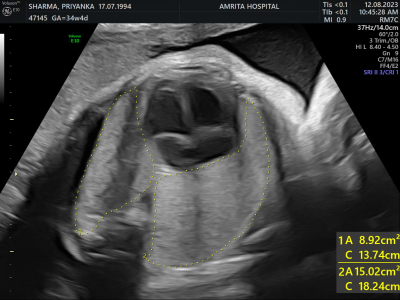

Displaying Grayscale Image:


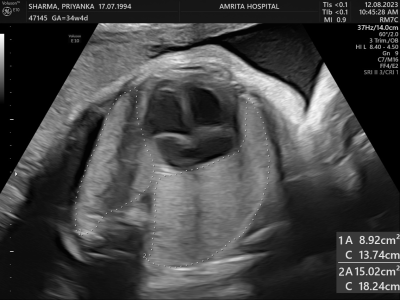

Displaying Noise Reduced Image:


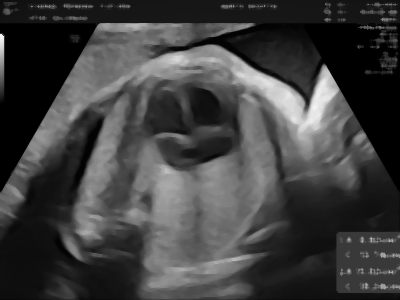

Displaying Normalized Image:


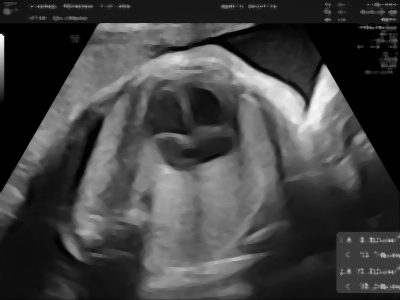

Preprocessing complete. Images saved to Google Drive.


In [ ]:
import cv2
import numpy as np
from google.colab.drive import mount
from google.colab.patches import cv2_imshow

mount('/content/drive')

image_path = '/content/drive/My Drive/22_8_11.jpg'
image = cv2.imread(image_path)

if image is None:
    print("Error: Unable to load image. Please check the file path.")
else:
    resized_image = cv2.resize(image, (400, 300), interpolation=cv2.INTER_AREA)
    print("Displaying Original Image:")
    cv2_imshow(resized_image)

    if len(resized_image.shape) == 2:
        gray_image = resized_image
    else:
        gray_image = cv2.cvtColor(resized_image, cv2.COLOR_BGR2GRAY)

    denoised_image = cv2.medianBlur(gray_image, 5)
    normalized_image = cv2.normalize(denoised_image, None, 0, 255, cv2.NORM_MINMAX)

    gray_image_resized = cv2.resize(gray_image, (400, 300), interpolation=cv2.INTER_AREA)
    denoised_image_resized = cv2.resize(denoised_image, (400, 300), interpolation=cv2.INTER_AREA)
    normalized_image_resized = cv2.resize(normalized_image, (400, 300), interpolation=cv2.INTER_AREA)

    print("Displaying Grayscale Image:")
    cv2_imshow(gray_image_resized)

    print("Displaying Noise Reduced Image:")
    cv2_imshow(denoised_image_resized)

    print("Displaying Normalized Image:")
    cv2_imshow(normalized_image_resized)

    cv2.imwrite('/content/drive/My Drive/original_image.jpg', resized_image)
    cv2.imwrite('/content/drive/My Drive/grayscale_image.jpg', gray_image)
    cv2.imwrite('/content/drive/My Drive/denoised_image.jpg', denoised_image)
    cv2.imwrite('/content/drive/My Drive/normalized_image.jpg', normalized_image)

    print("Preprocessing complete. Images saved to Google Drive.")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


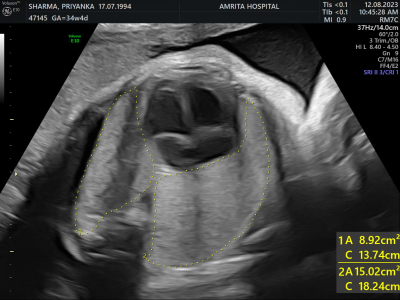

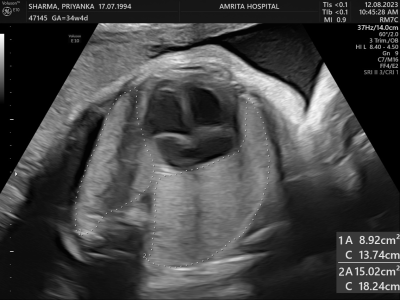

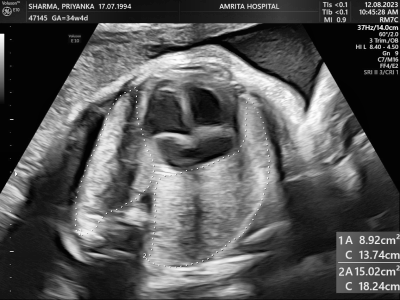

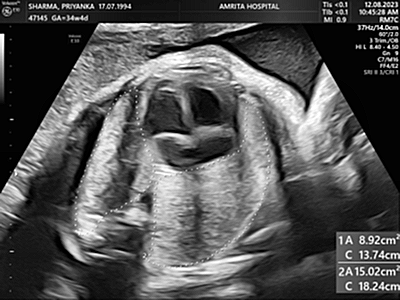

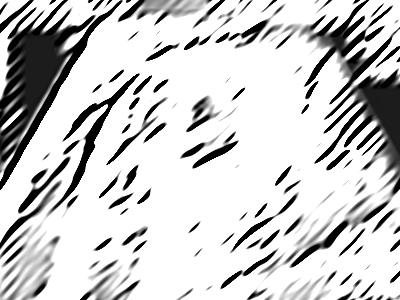

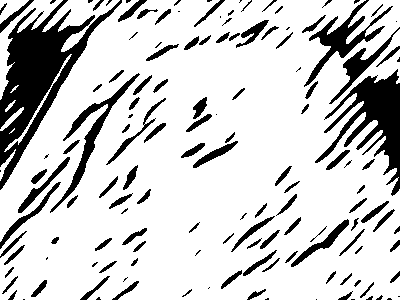

Preprocessing complete. Images saved to Google Drive.


In [ ]:
import cv2
import numpy as np
from google.colab.drive import mount
from google.colab.patches import cv2_imshow

mount('/content/drive')
image_path = '/content/drive/My Drive/22_8_11.jpg'
image = cv2.imread(image_path)

if image is None:
    print("Error: Unable to load image. Please check the file path.")
else:
    resized_image = cv2.resize(image, (400, 300), interpolation=cv2.INTER_AREA)
    cv2_imshow(resized_image)

    if len(resized_image.shape) == 2:
        gray_image = resized_image
    else:
        gray_image = cv2.cvtColor(resized_image, cv2.COLOR_BGR2GRAY)

    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    clahe_image = clahe.apply(gray_image)

    blurred_image = cv2.GaussianBlur(clahe_image, (3, 3), 0)

    sharpening_kernel = np.array([[0, -1, 0],
                                   [-1, 5, -1],
                                   [0, -1, 0]])
    sharpened_image = cv2.filter2D(blurred_image, -1, sharpening_kernel)

    kernel_size = 31
    sigma = 4.0
    theta = np.pi / 4
    lambd = 10.0
    gamma = 0.5
    gabor_kernel = cv2.getGaborKernel((kernel_size, kernel_size), sigma, theta, lambd, gamma, 0, ktype=cv2.CV_32F)

    gabor_filtered = cv2.filter2D(sharpened_image, cv2.CV_8UC3, gabor_kernel)

    gabor_normalized = cv2.normalize(gabor_filtered, None, 0, 255, cv2.NORM_MINMAX)

    _, gabor_thresholded = cv2.threshold(gabor_normalized, 128, 255, cv2.THRESH_BINARY)

    resized_gray = cv2.resize(gray_image, (400, 300), interpolation=cv2.INTER_AREA)
    resized_clahe = cv2.resize(clahe_image, (400, 300), interpolation=cv2.INTER_AREA)
    resized_sharpened = cv2.resize(sharpened_image, (400, 300), interpolation=cv2.INTER_AREA)
    resized_gabor = cv2.resize(gabor_normalized, (400, 300), interpolation=cv2.INTER_AREA)
    resized_thresholded = cv2.resize(gabor_thresholded, (400, 300), interpolation=cv2.INTER_AREA)

    cv2_imshow(resized_gray)
    cv2_imshow(resized_clahe)
    cv2_imshow(resized_sharpened)
    cv2_imshow(resized_gabor)
    cv2_imshow(resized_thresholded)

    cv2.imwrite('/content/drive/My Drive/original_image.jpg', resized_image)
    cv2.imwrite('/content/drive/My Drive/grayscale_image.jpg', gray_image)
    cv2.imwrite('/content/drive/My Drive/clahe_image.jpg', clahe_image)
    cv2.imwrite('/content/drive/My Drive/sharpened_image.jpg', sharpened_image)
    cv2.imwrite('/content/drive/My Drive/gabor_filtered.jpg', gabor_filtered)
    cv2.imwrite('/content/drive/My Drive/gabor_thresholded.jpg', gabor_thresholded)

    print("Preprocessing complete. Images saved to Google Drive.")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


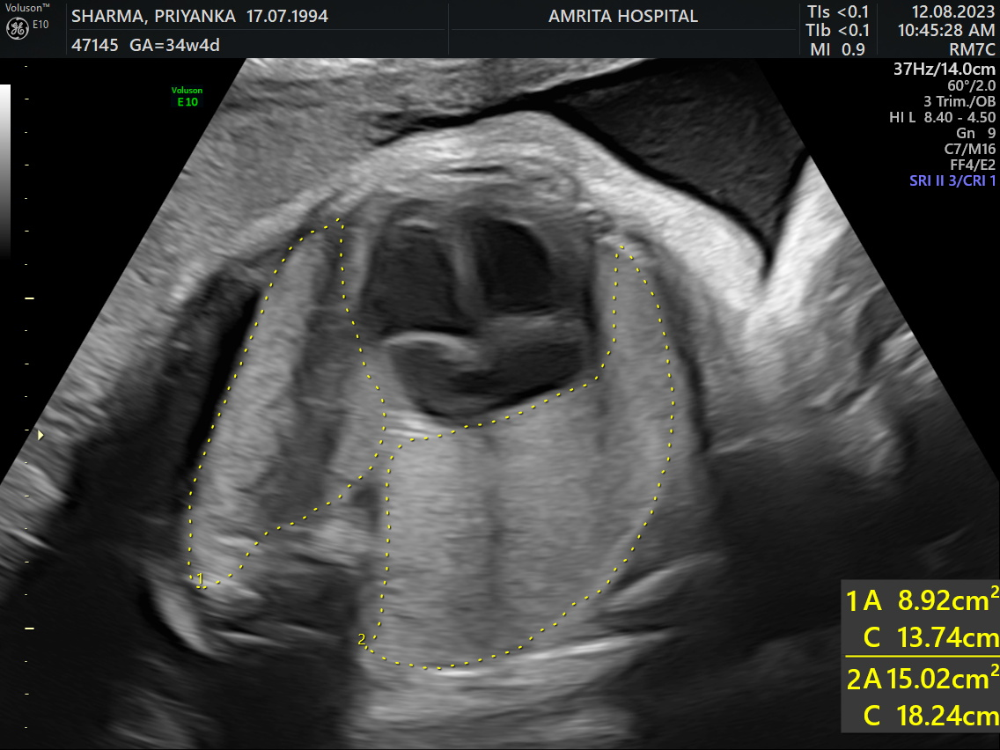

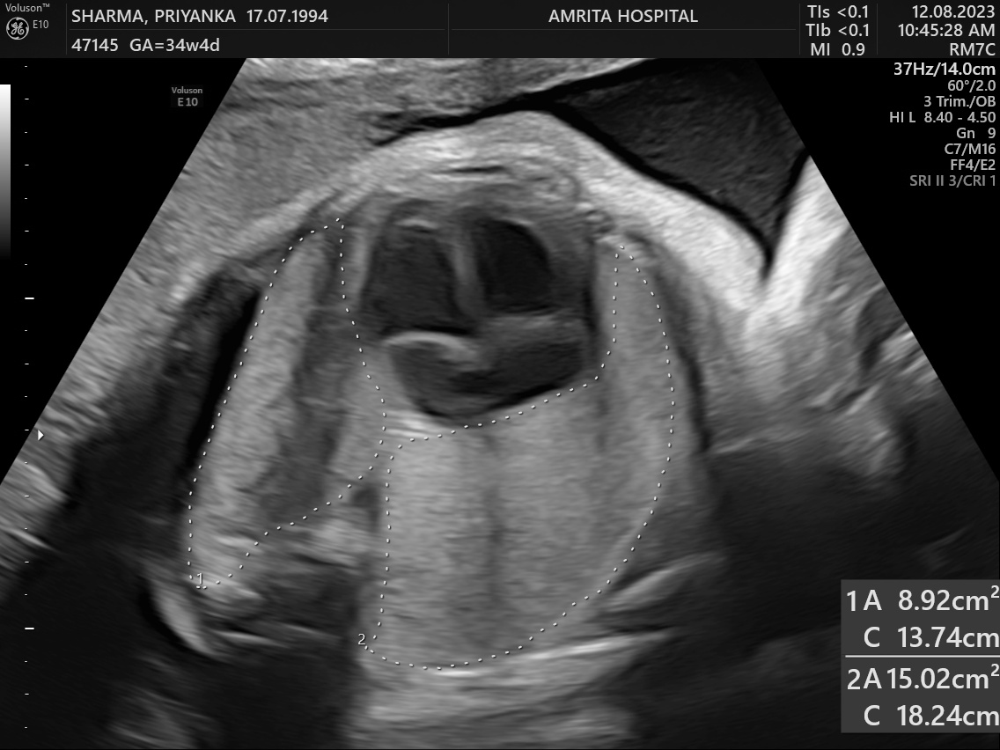

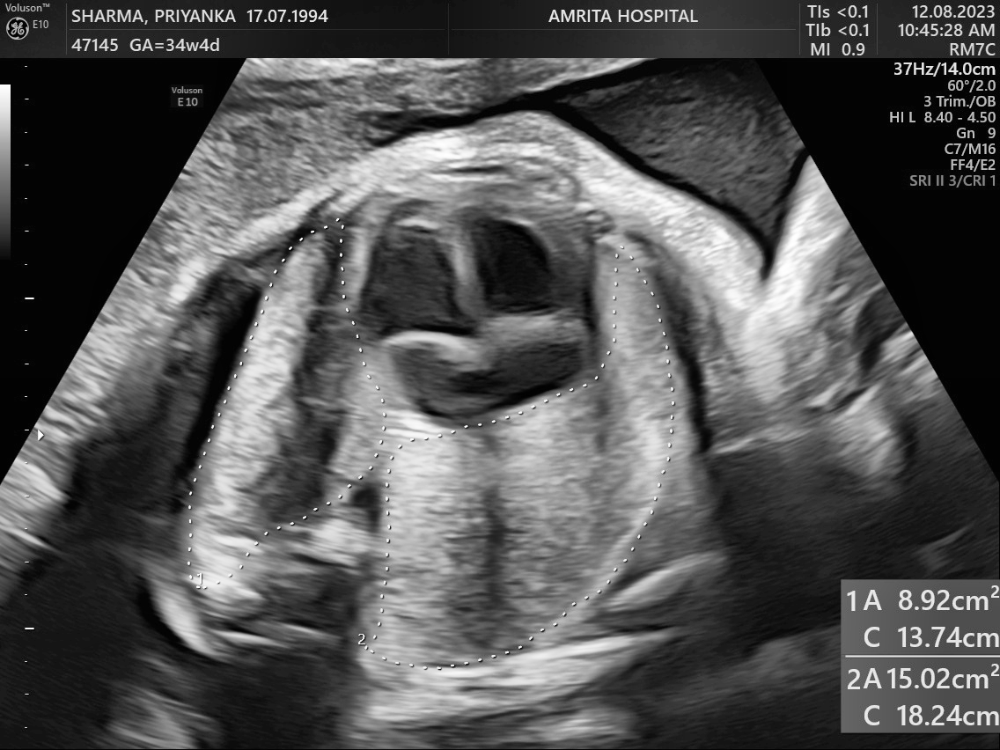

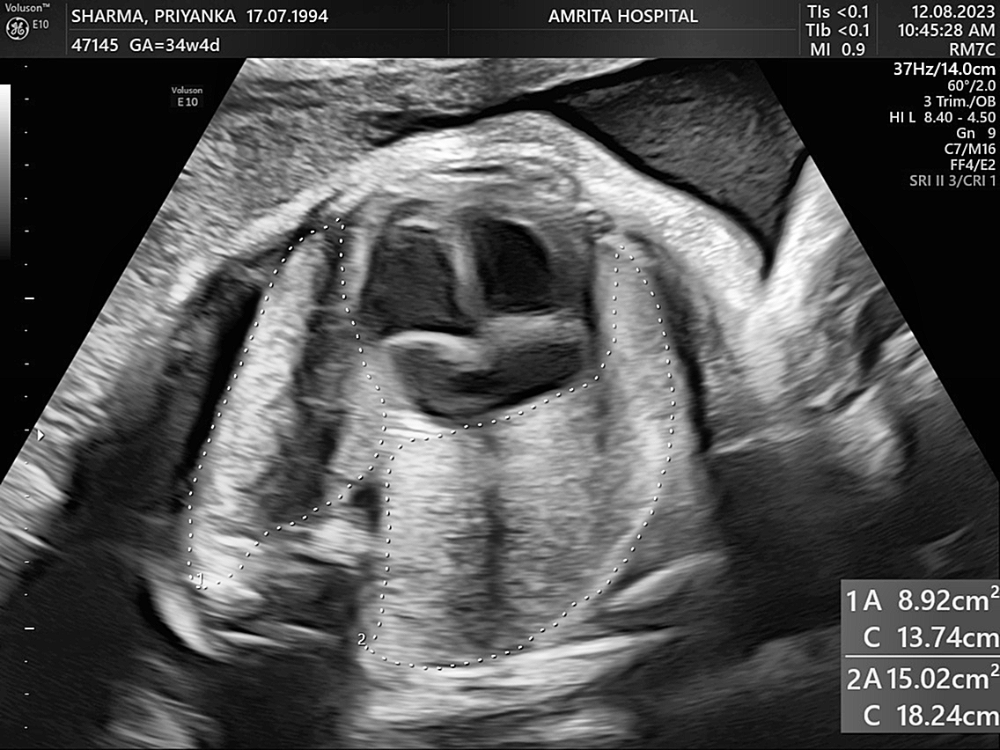

Preprocessing complete. Images saved to Google Drive.
Applying Anisotropic diffusion
Side-by-side Comparison: Grayscale (Left) vs Anisotropic Diffusion (Right)


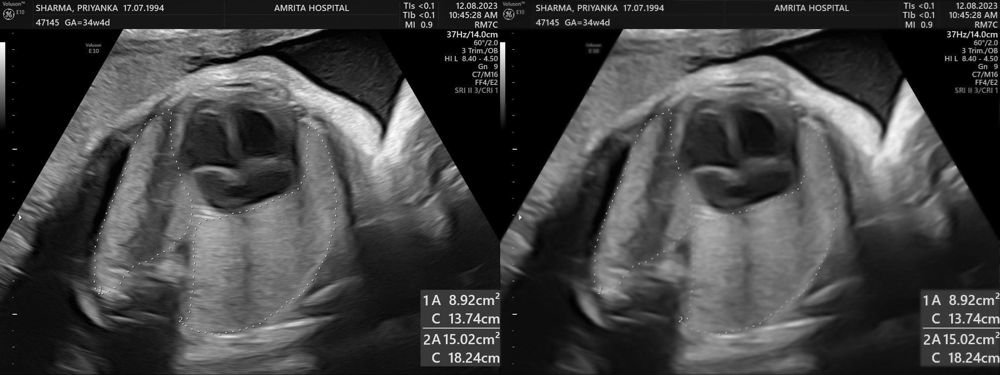

Side-by-side Comparison: Diffused Image (Left) vs Edges (Right)


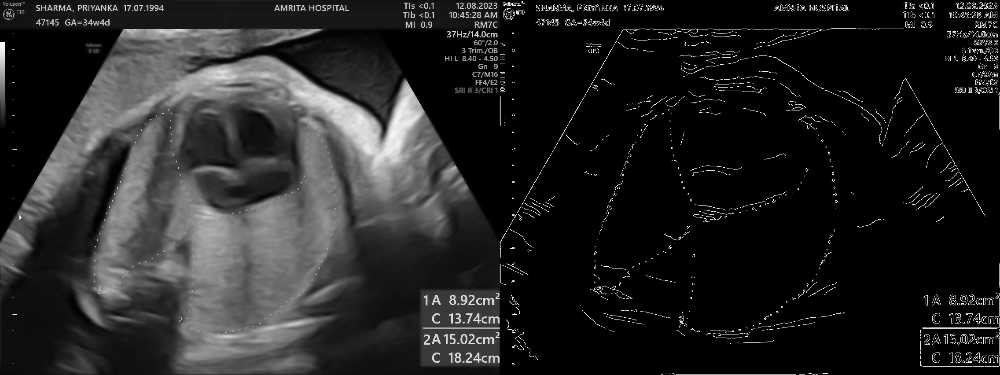

Edge-detected image saved to Google Drive.


In [ ]:
import cv2
import numpy as np
from google.colab.drive import mount
from google.colab.patches import cv2_imshow

mount('/content/drive')
image_path = '/content/drive/My Drive/22_8_11.jpg'
image = cv2.imread(image_path)

if image is None:
    print("Error: Unable to load image. Please check the file path.")
else:
    cv2_imshow(image)  # Display the original image

    if len(image.shape) == 2:
        gray_image = image
    else:
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    clahe_image = clahe.apply(gray_image)

    blurred_image = cv2.GaussianBlur(clahe_image, (3, 3), 0)

    sharpening_kernel = np.array([[0, -1, 0],
                                   [-1, 5, -1],
                                   [0, -1, 0]])
    sharpened_image = cv2.filter2D(blurred_image, -1, sharpening_kernel)

    cv2_imshow(gray_image)
    cv2_imshow(clahe_image)
    cv2_imshow(sharpened_image)

    # Save preprocessed images to Google Drive
    cv2.imwrite('/content/drive/My Drive/original_image.jpg', image)
    cv2.imwrite('/content/drive/My Drive/grayscale_image.jpg', gray_image)
    cv2.imwrite('/content/drive/My Drive/clahe_image.jpg', clahe_image)
    cv2.imwrite('/content/drive/My Drive/sharpened_image.jpg', sharpened_image)

    print("Preprocessing complete. Images saved to Google Drive.")

    def anisotropic_diffusion(image, num_iter=10, kappa=50, gamma=0.1, option=1):
        """
        Perform anisotropic diffusion on an image.

        Parameters:
        - image: Input image (grayscale).
        - num_iter: Number of iterations to perform.
        - kappa: Gradient threshold for conduction coefficients.
        - gamma: Integration constant (time step).
        - option: Type of diffusion function (1: exponential, 2: quadratic).

        Returns:
        - diffused_image: Image after anisotropic diffusion.
        """
        image = image.astype(np.float32)
        diffused_image = image.copy()

        for _ in range(num_iter):
            # Compute gradients
            delta_n = np.roll(diffused_image, -1, axis=0) - diffused_image
            delta_s = np.roll(diffused_image, 1, axis=0) - diffused_image
            delta_e = np.roll(diffused_image, -1, axis=1) - diffused_image
            delta_w = np.roll(diffused_image, 1, axis=1) - diffused_image

            # Compute conduction coefficients
            if option == 1:  # Exponential function
                c_n = np.exp(-(delta_n / kappa) ** 2)
                c_s = np.exp(-(delta_s / kappa) ** 2)
                c_e = np.exp(-(delta_e / kappa) ** 2)
                c_w = np.exp(-(delta_w / kappa) ** 2)
            elif option == 2:  # Quadratic function
                c_n = 1 / (1 + (delta_n / kappa) ** 2)
                c_s = 1 / (1 + (delta_s / kappa) ** 2)
                c_e = 1 / (1 + (delta_e / kappa) ** 2)
                c_w = 1 / (1 + (delta_w / kappa) ** 2)
            else:
                raise ValueError("Invalid option for conduction coefficients. Use 1 or 2.")

            # Update the diffused image
            diffused_image += gamma * (
                c_n * delta_n + c_s * delta_s + c_e * delta_e + c_w * delta_w
            )

        return diffused_image

    print("Applying Anisotropic diffusion")
    diffused_image = anisotropic_diffusion(gray_image, num_iter=15, kappa=50, gamma=0.2, option=1)
    comparison = np.hstack((gray_image, diffused_image))  # Stack images horizontally
    print("Side-by-side Comparison: Grayscale (Left) vs Anisotropic Diffusion (Right)")
    cv2_imshow(comparison)  # Display the side-by-side comparison

    # Apply Canny edge detection
    low_threshold = 0  # Lower bound for the hysteresis thresholding
    high_threshold = 80  # Upper bound for the hysteresis thresholding

    # Ensure the diffused image is in the correct range
    diffused_image_uint8 = np.uint8(cv2.normalize(diffused_image, None, 0, 255, cv2.NORM_MINMAX))

    edges = cv2.Canny(diffused_image_uint8, low_threshold, high_threshold)

    # Display the diffused image and edges side by side
    comparison_with_edges = np.hstack((diffused_image_uint8, edges))
    print("Side-by-side Comparison: Diffused Image (Left) vs Edges (Right)")
    cv2_imshow(comparison_with_edges)

    # Save the edge-detected image to Google Drive
    cv2.imwrite('/content/drive/My Drive/edges_image.jpg', edges)
    print("Edge-detected image saved to Google Drive.")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


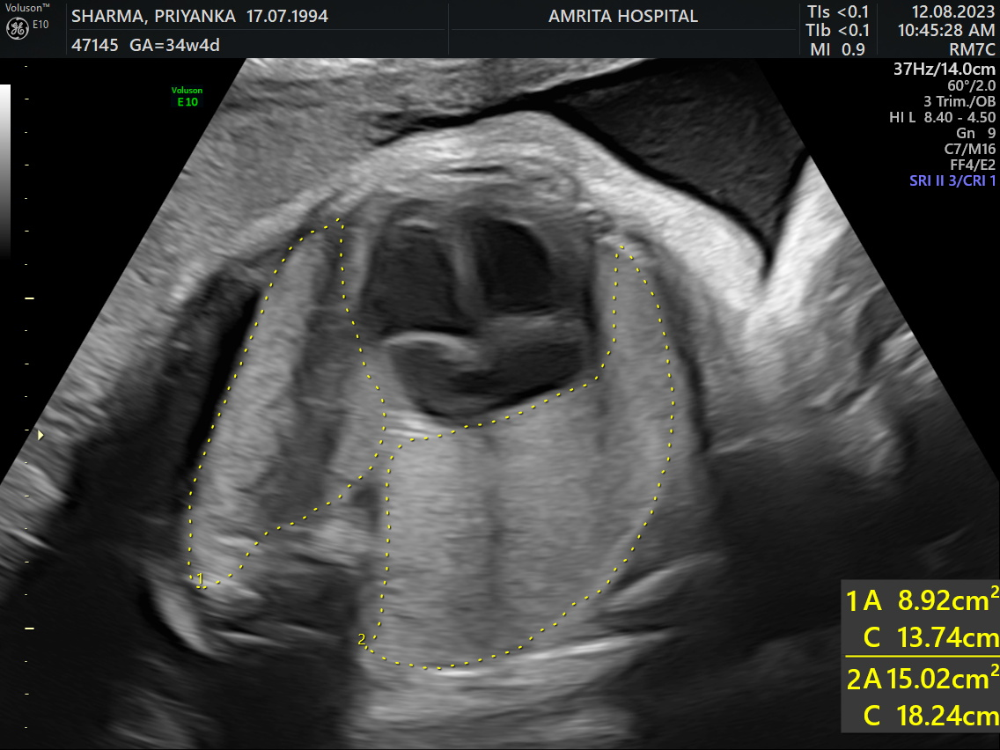

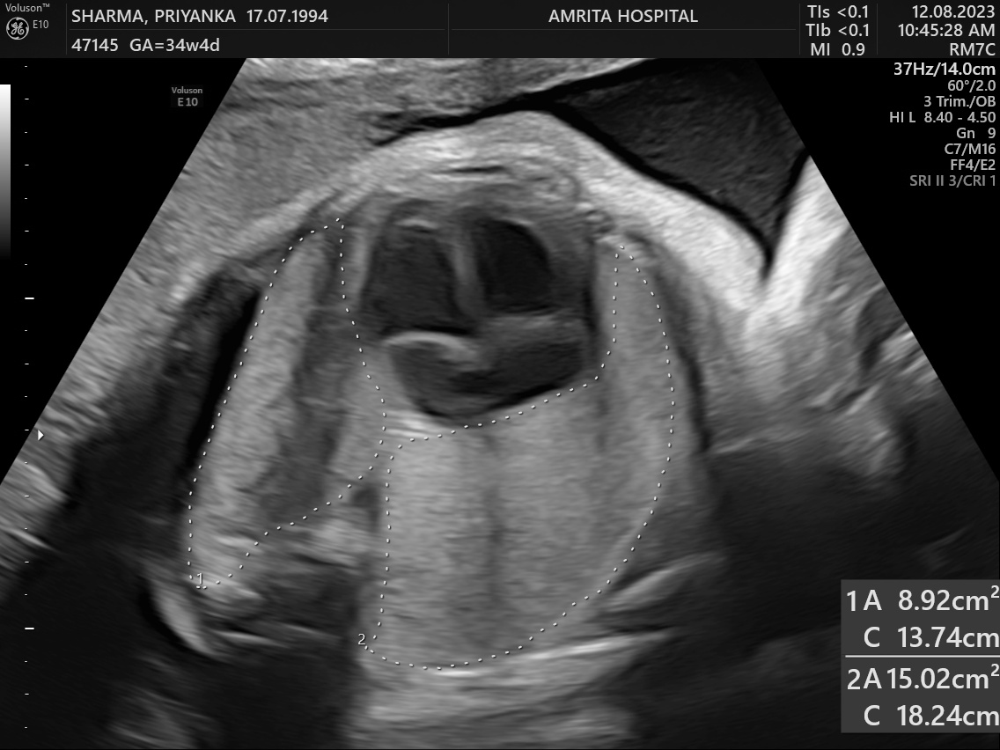

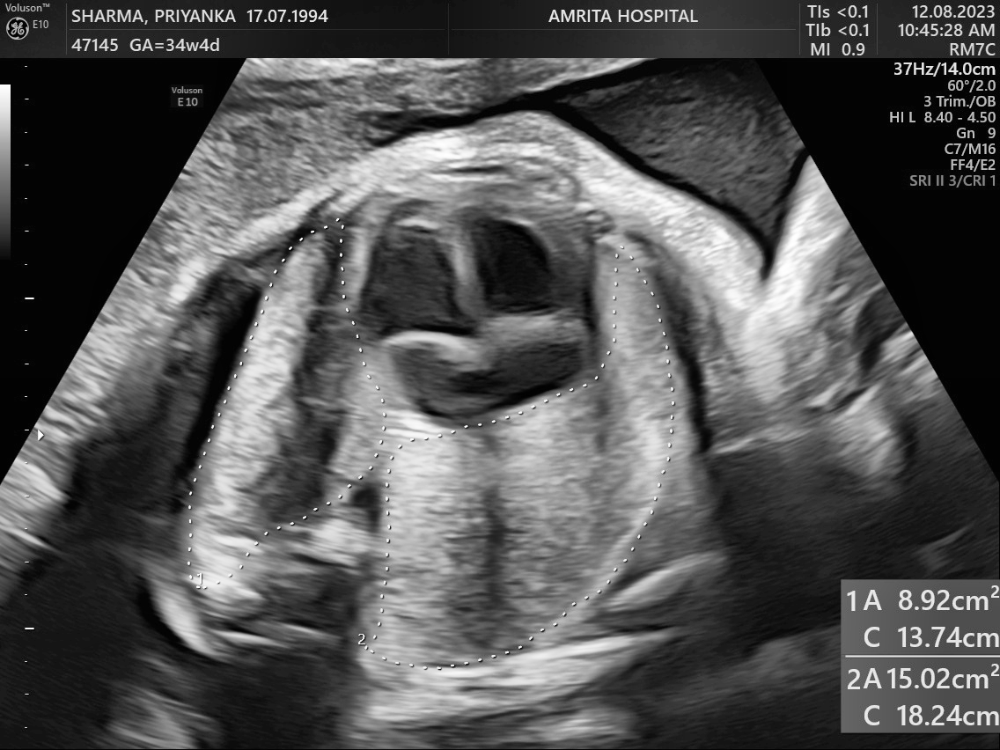

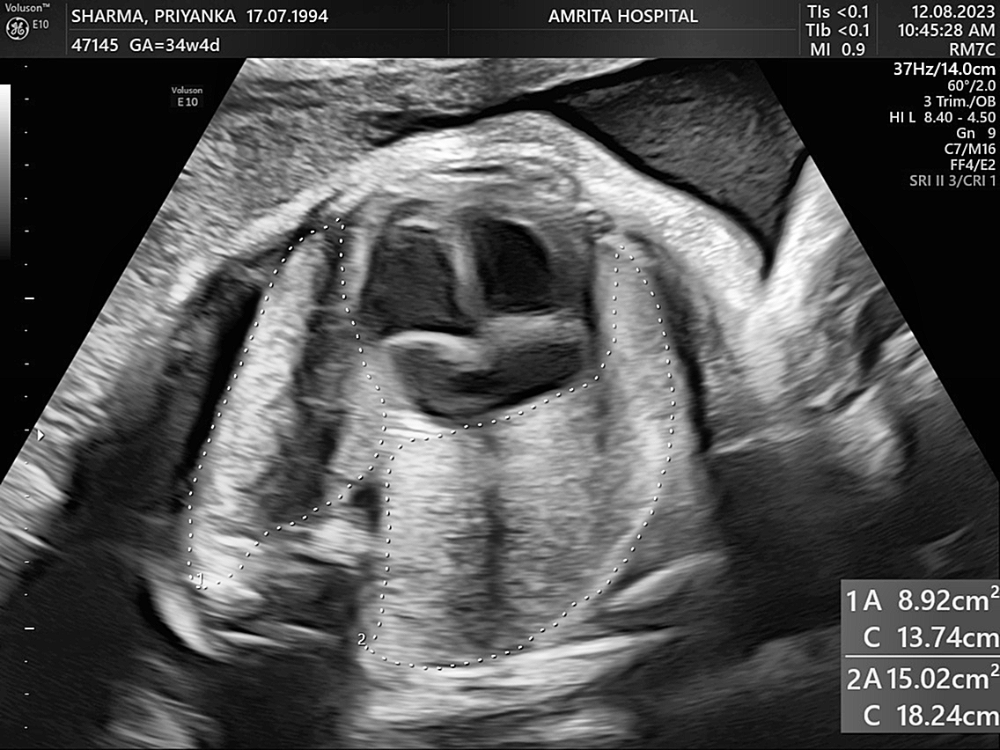

Preprocessing complete. Images saved to Google Drive.
Applying Anisotropic diffusion
Side-by-side Comparison: Grayscale (Left) vs Anisotropic Diffusion (Right)


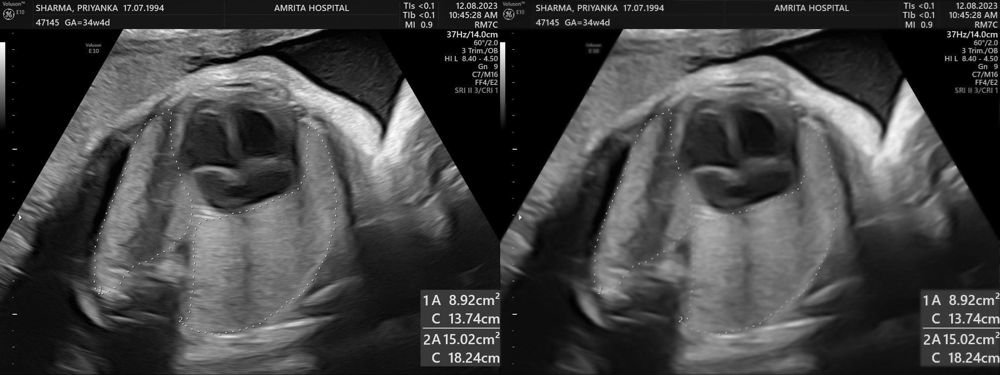

Applying GLCM for grayscale...

GLCM Features:
contrast: 	[190.59600629 350.87335863 192.2177761  318.65196788]
dissimilarity: 	[3.13379661 5.35825901 4.02849175 5.21312993]
homogeneity: 	[0.5728802  0.43224254 0.45368384 0.43644271]
energy: 	[0.12837612 0.12425265 0.12512287 0.12439985]
correlation: 	[0.96972783 0.9442776  0.96948039 0.94939469]
ASM: 	[0.01648043 0.01543872 0.01565573 0.01547532]


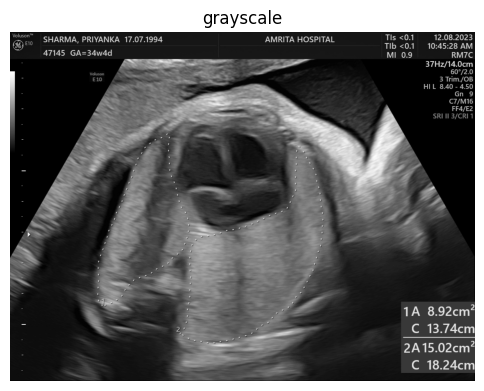

Applying GLCM for anisotropic_image...

Converting image from float32 to uint8.
GLCM Features:
contrast: 	[192.37310087 304.79673667 171.7136064  286.68200873]
dissimilarity: 	[2.24589977 3.61744307 2.35843808 3.41676079]
homogeneity: 	[0.67420511 0.55941488 0.62222051 0.56916494]
energy: 	[0.12804468 0.12398267 0.12616526 0.12433478]
correlation: 	[0.96821057 0.94965375 0.97164068 0.95264594]
ASM: 	[0.01639544 0.0153717  0.01591767 0.01545914]


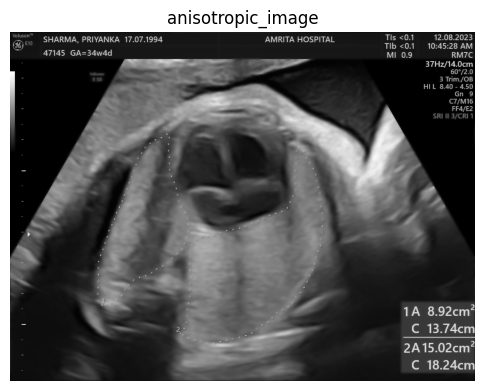

Side-by-side Comparison: Diffused Image (Left) vs Edges (Right)


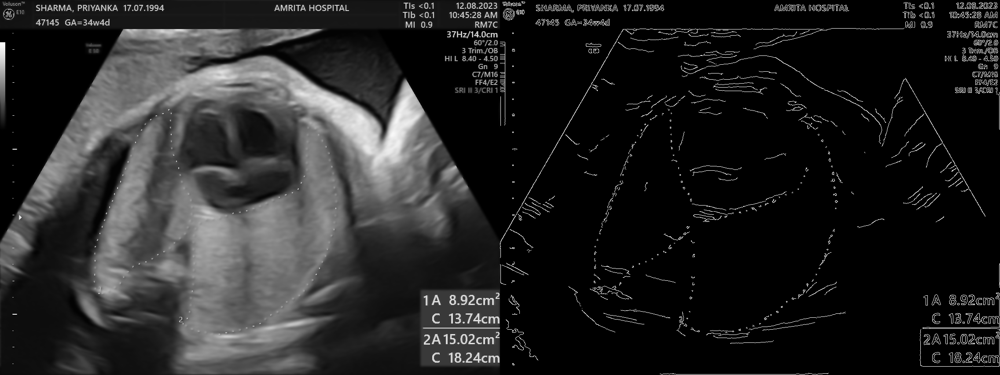

Edge-detected image saved to Google Drive.


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab.drive import mount
from google.colab.patches import cv2_imshow
from skimage.feature import graycomatrix, graycoprops

# Mount Google Drive
mount('/content/drive')
image_path = '/content/drive/My Drive/22_8_11.jpg'
image = cv2.imread(image_path)

if image is None:
    print("Error: Unable to load image. Please check the file path.")
else:
    cv2_imshow(image)  # Display the original image

    if len(image.shape) == 2:
        gray_image = image
    else:
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    clahe_image = clahe.apply(gray_image)

    blurred_image = cv2.GaussianBlur(clahe_image, (3, 3), 0)

    sharpening_kernel = np.array([[0, -1, 0],
                                   [-1, 5, -1],
                                   [0, -1, 0]])
    sharpened_image = cv2.filter2D(blurred_image, -1, sharpening_kernel)

    cv2_imshow(gray_image)
    cv2_imshow(clahe_image)
    cv2_imshow(sharpened_image)

    # Save preprocessed images to Google Drive
    cv2.imwrite('/content/drive/My Drive/original_image.jpg', image)
    cv2.imwrite('/content/drive/My Drive/grayscale_image.jpg', gray_image)
    cv2.imwrite('/content/drive/My Drive/clahe_image.jpg', clahe_image)
    cv2.imwrite('/content/drive/My Drive/sharpened_image.jpg', sharpened_image)

    print("Preprocessing complete. Images saved to Google Drive.")

    def anisotropic_diffusion(image, num_iter=10, kappa=50, gamma=0.1, option=1):
        """
        Perform anisotropic diffusion on an image.

        Parameters:
        - image: Input image (grayscale).
        - num_iter: Number of iterations to perform.
        - kappa: Gradient threshold for conduction coefficients.
        - gamma: Integration constant (time step).
        - option: Type of diffusion function (1: exponential, 2: quadratic).

        Returns:
        - diffused_image: Image after anisotropic diffusion.
        """
        image = image.astype(np.float32)
        diffused_image = image.copy()

        for _ in range(num_iter):
            # Compute gradients
            delta_n = np.roll(diffused_image, -1, axis=0) - diffused_image
            delta_s = np.roll(diffused_image, 1, axis=0) - diffused_image
            delta_e = np.roll(diffused_image, -1, axis=1) - diffused_image
            delta_w = np.roll(diffused_image, 1, axis=1) - diffused_image

            # Compute conduction coefficients
            if option == 1:  # Exponential function
                c_n = np.exp(-(delta_n / kappa) ** 2)
                c_s = np.exp(-(delta_s / kappa) ** 2)
                c_e = np.exp(-(delta_e / kappa) ** 2)
                c_w = np.exp(-(delta_w / kappa) ** 2)
            elif option == 2:  # Quadratic function
                c_n = 1 / (1 + (delta_n / kappa) ** 2)
                c_s = 1 / (1 + (delta_s / kappa) ** 2)
                c_e = 1 / (1 + (delta_e / kappa) ** 2)
                c_w = 1 / (1 + (delta_w / kappa) ** 2)
            else:
                raise ValueError("Invalid option for conduction coefficients. Use 1 or 2.")

            # Update the diffused image
            diffused_image += gamma * (
                c_n * delta_n + c_s * delta_s + c_e * delta_e + c_w * delta_w
            )

        return diffused_image

    print("Applying Anisotropic diffusion")
    diffused_image = anisotropic_diffusion(gray_image, num_iter=15, kappa=50, gamma=0.2, option=1)
    comparison = np.hstack((gray_image, diffused_image))  # Stack images horizontally
    print("Side-by-side Comparison: Grayscale (Left) vs Anisotropic Diffusion (Right)")
    cv2_imshow(comparison)  # Display the side-by-side comparison

    # Compute GLCM features
    def compute_glcm_features(image, distances, angles):
        """
        Compute GLCM and its properties for a grayscale image.

        Parameters:
            image (numpy.ndarray): Input grayscale image.
            distances (list): List of pixel pair distance offsets.
            angles (list): List of pixel pair angles in radians.

        Returns:
            dict: Dictionary of GLCM properties.
        """
        if not np.issubdtype(image.dtype, np.integer):
            print(f"Converting image from {image.dtype} to uint8.")
            image = (image * 255).astype(np.uint8) if image.max() <= 1 else image.astype(np.uint8)

        glcm = graycomatrix(image, distances=distances, angles=angles, levels=256, symmetric=True, normed=True)

        features = {
            'contrast': graycoprops(glcm, 'contrast').flatten(),
            'dissimilarity': graycoprops(glcm, 'dissimilarity').flatten(),
            'homogeneity': graycoprops(glcm, 'homogeneity').flatten(),
            'energy': graycoprops(glcm, 'energy').flatten(),
            'correlation': graycoprops(glcm, 'correlation').flatten(),
            'ASM': graycoprops(glcm, 'ASM').flatten(),
        }

        return features

    # Parameters for GLCM
    distances = [1]  # Example distances
    angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]  # Example angles

    # Preprocessed images for GLCM
    preprocessed_images = {"grayscale": gray_image, "anisotropic_image": diffused_image}

    for image_name, image in preprocessed_images.items():
        print(f"Applying GLCM for {image_name}...\n")
        features = compute_glcm_features(image, distances, angles)

        print("GLCM Features:")
        for feature_name, values in features.items():
            print(f"{feature_name}: \t{values}")

        # Display the original image
        plt.figure(figsize=(6, 6))
        plt.title(image_name)
        plt.imshow(image, cmap='gray')
        plt.axis('off')
        plt.show()

    # Apply Canny edge detection after GLCM feature extraction
    low_threshold = 0  # Lower bound for the hysteresis thresholding
    high_threshold = 78  # Upper bound for the hysteresis thresholding

    diffused_image_uint8 = np.uint8(cv2.normalize(diffused_image, None, 0, 255, cv2.NORM_MINMAX))

    edges = cv2.Canny(diffused_image_uint8, low_threshold, high_threshold)

    # Display the diffused image and edges side by side
    comparison_with_edges = np.hstack((diffused_image_uint8, edges))
    print("Side-by-side Comparison: Diffused Image (Left) vs Edges (Right)")
    cv2_imshow(comparison_with_edges)

    # Save the edge-detected image to Google Drive
    cv2.imwrite('/content/drive/My Drive/edges_image.jpg', edges)
    print("Edge-detected image saved to Google Drive.")


Final Code using CLAHE, Diffusion, GLCM, Canny Edge Detection

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Processing image: 22_8_11.jpg
Original image




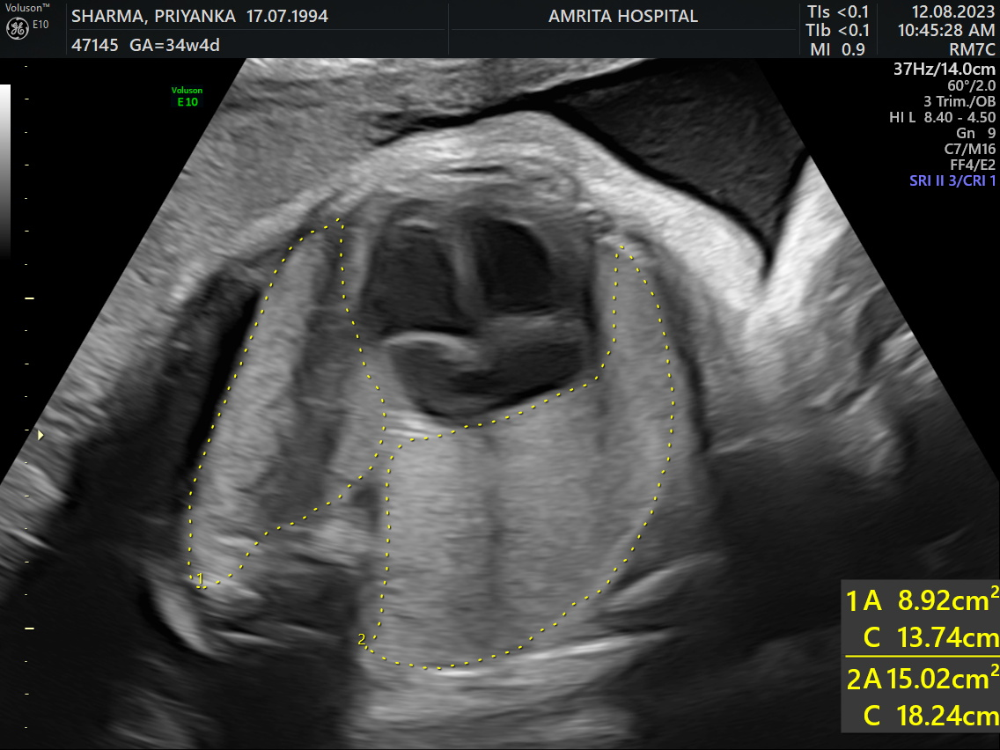

Gray scale image




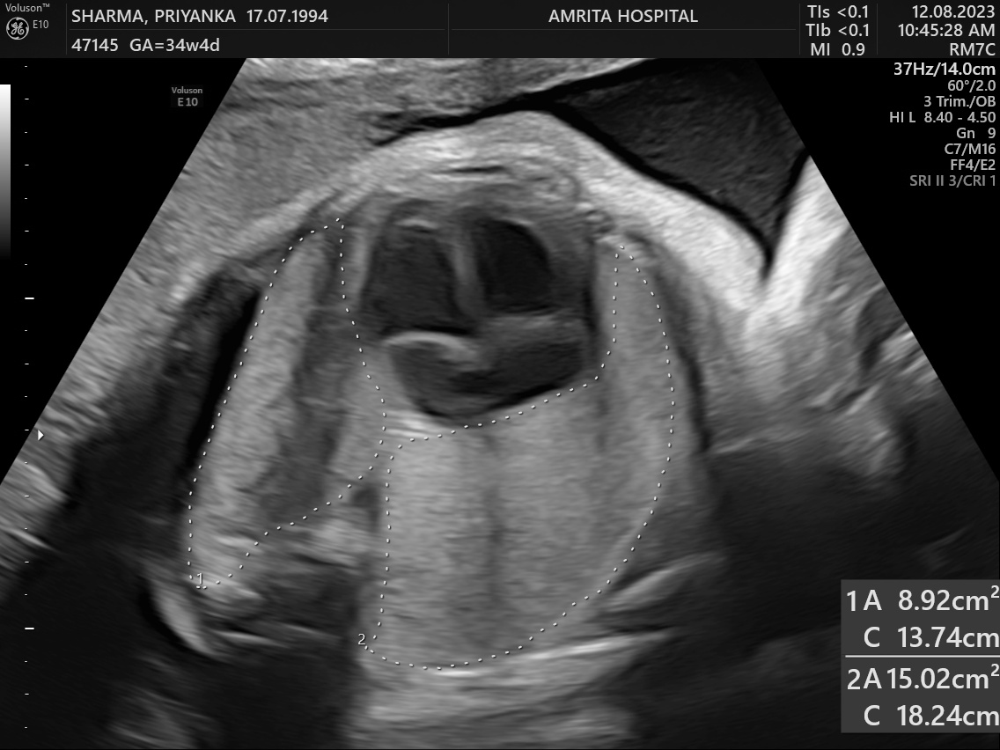

Applying clahe 




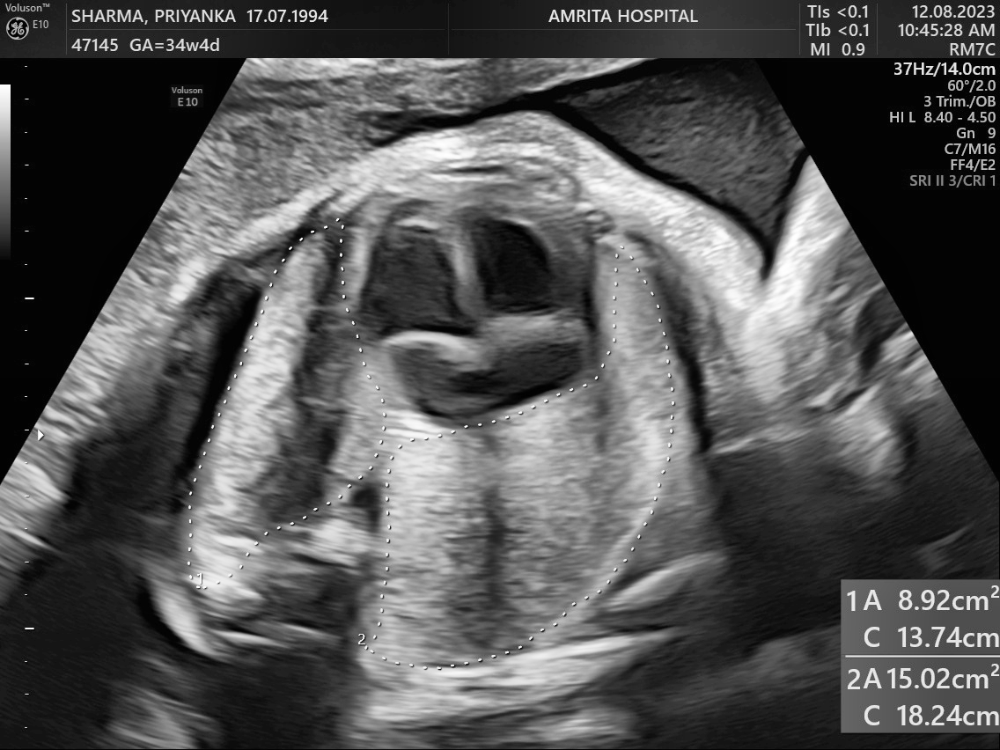

applying diffusion


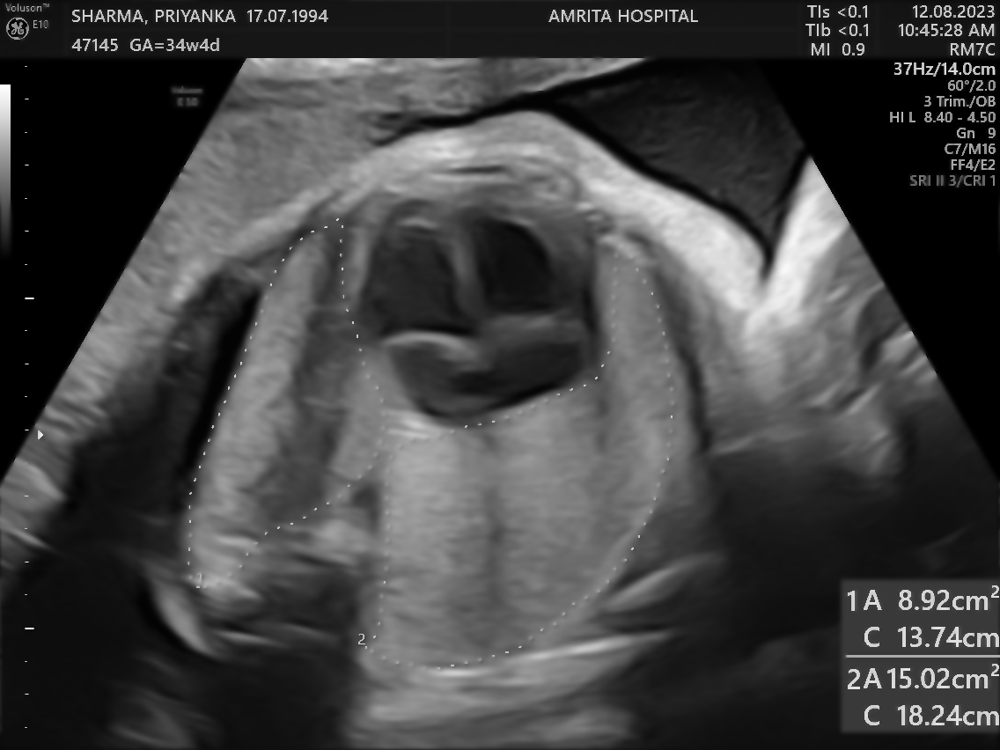

GLCM Features:
contrast: 	[195.02589192 308.96889795 174.07026324 290.63125424]
dissimilarity: 	[2.26091911 3.64158052 2.37447866 3.43979356]
homogeneity: 	[0.67318271 0.55841512 0.62097669 0.56811413]
energy: 	[0.12801624 0.12397394 0.12613477 0.12431595]
correlation: 	[0.96821038 0.94965847 0.97164231 0.95264629]
ASM: 	[0.01638816 0.01536954 0.01590998 0.01545446]


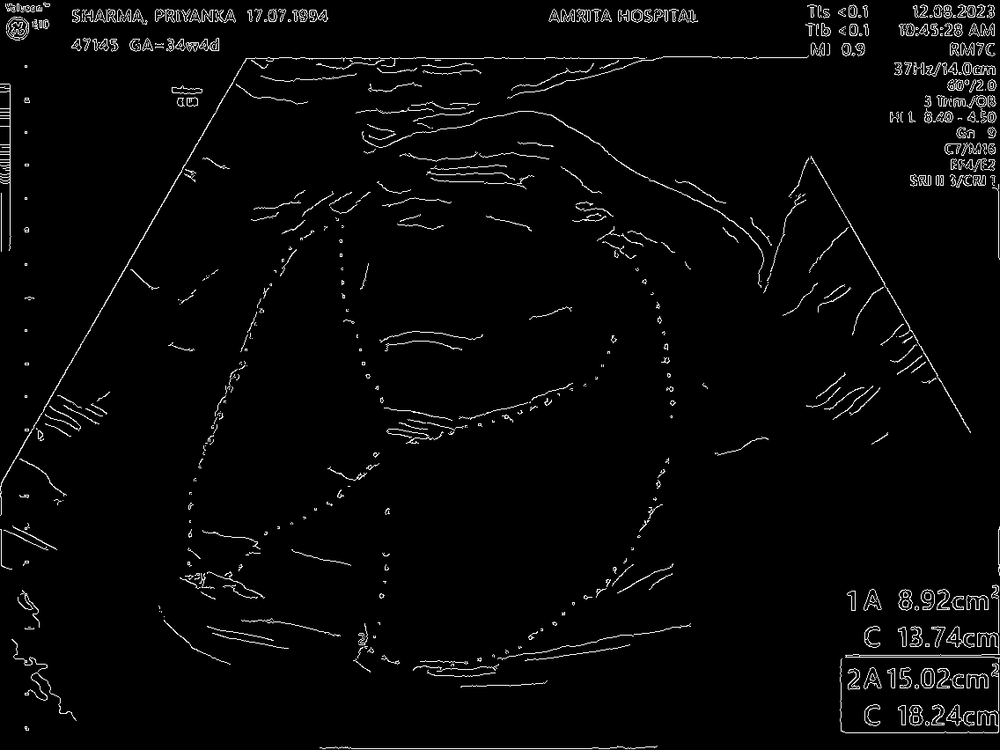

Applying edges
Processing complete for 22_8_11.jpg. Results saved to /content/drive/My Drive/AIMS_Processed/22_8_11.

Processing image: LUNG 2 SETTINGS_1.jpg
Original image




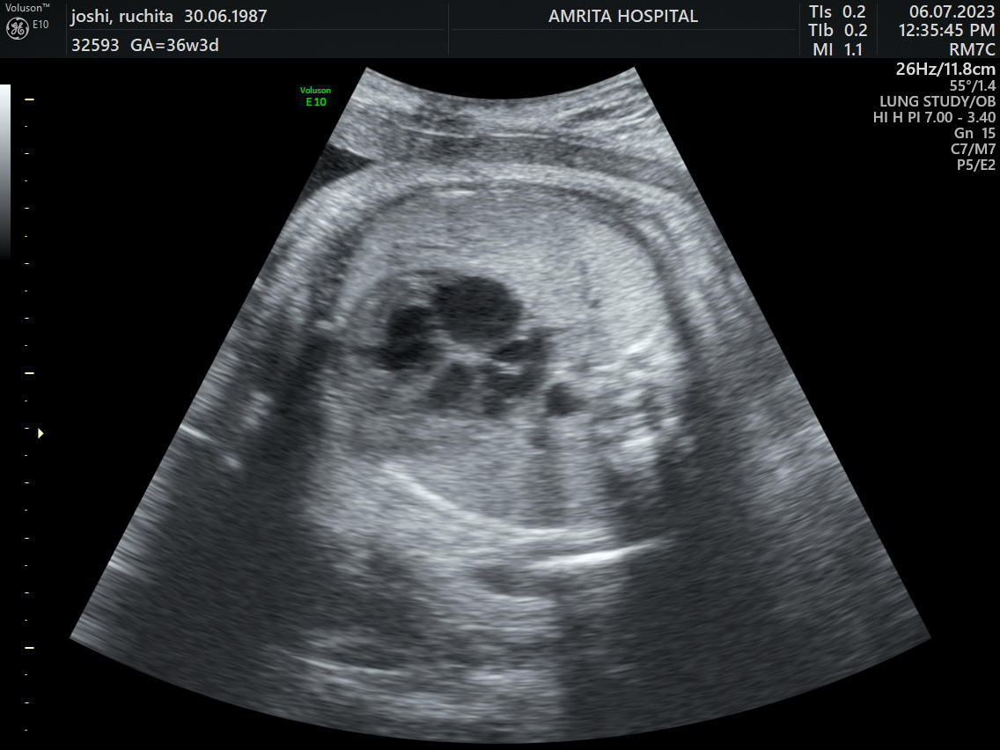

Gray scale image




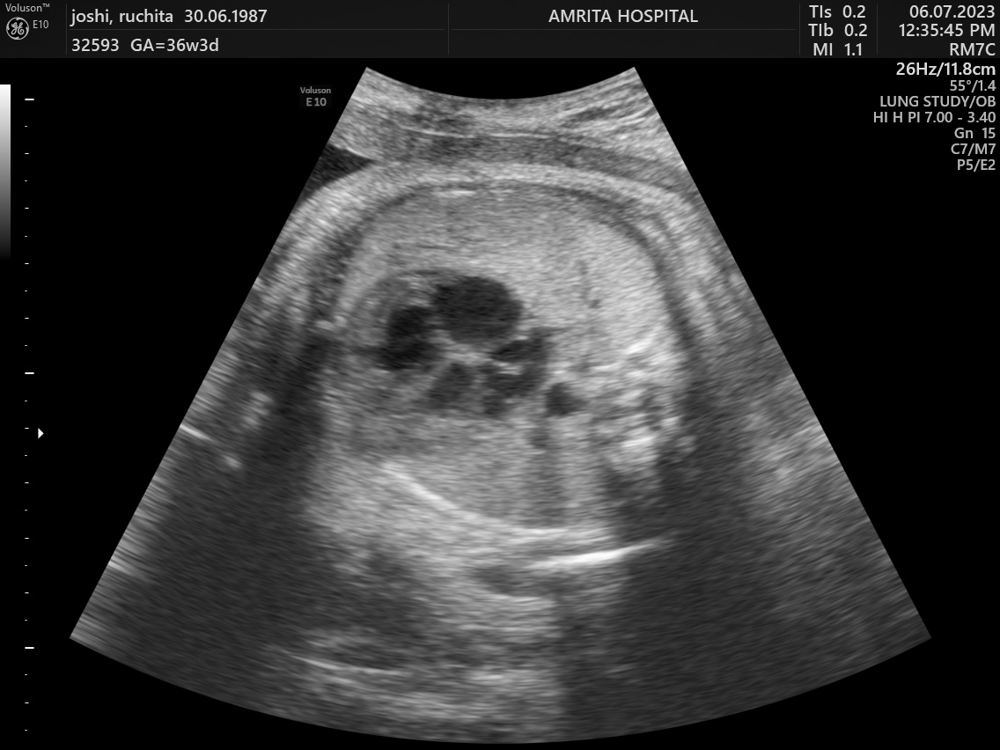

Applying clahe 




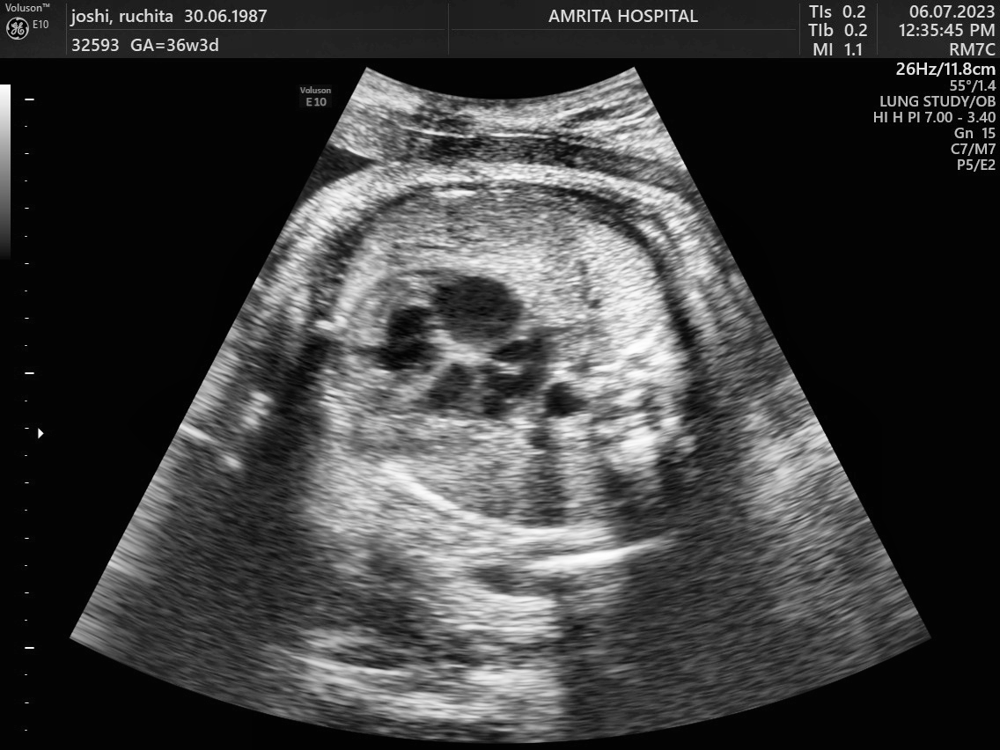

applying diffusion


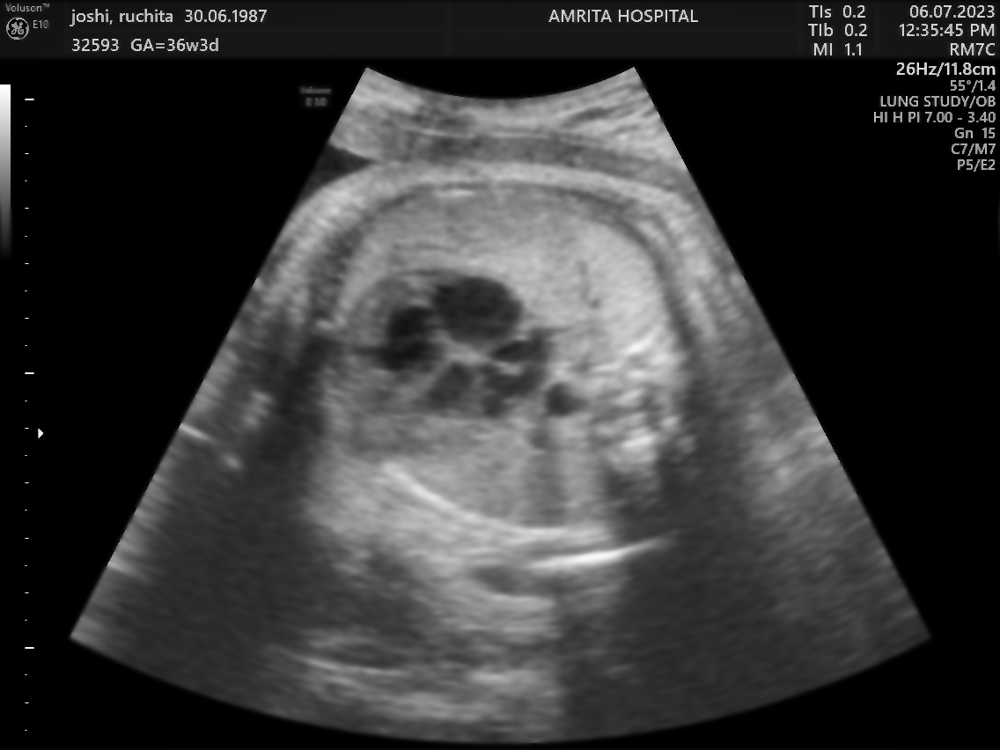

GLCM Features:
contrast: 	[147.0096513  229.93805577 129.77584159 220.74629485]
dissimilarity: 	[1.68803231 2.78927098 1.93099874 2.73828354]
homogeneity: 	[0.74414951 0.63682544 0.66697082 0.63854273]
energy: 	[0.37805557 0.37621943 0.37736355 0.37624365]
correlation: 	[0.97903186 0.96722063 0.98150082 0.96853098]
ASM: 	[0.14292602 0.14154106 0.14240325 0.14155929]


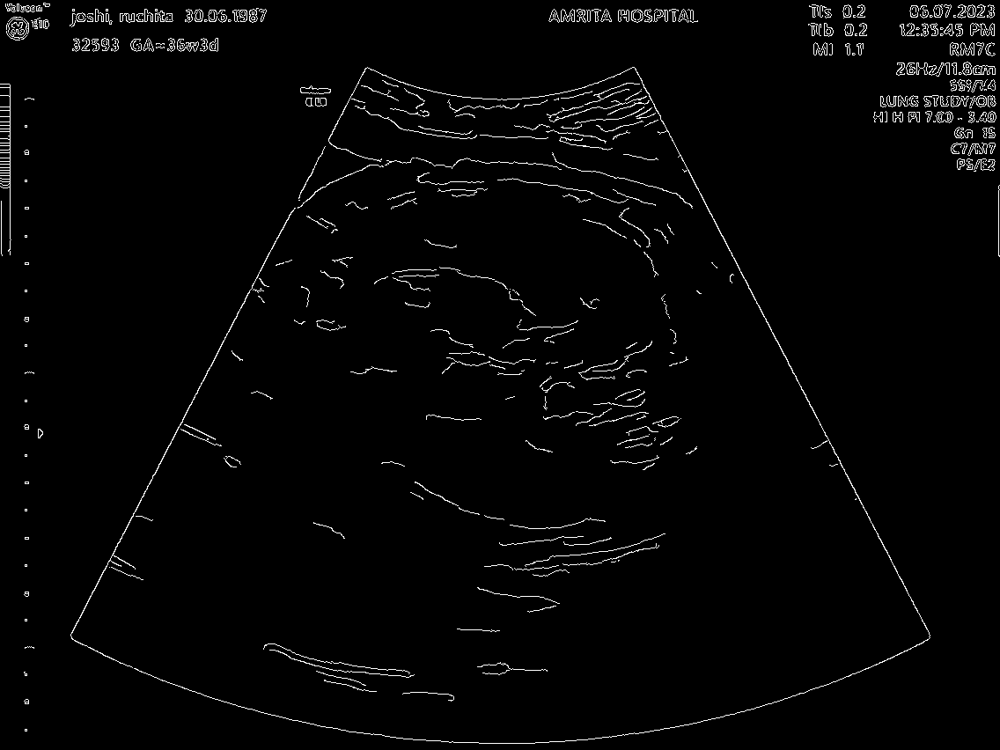

Applying edges
Processing complete for LUNG 2 SETTINGS_1.jpg. Results saved to /content/drive/My Drive/AIMS_Processed/LUNG 2 SETTINGS_1.

Processing image: LUNG 2 SETTINGS_3.jpg
Original image




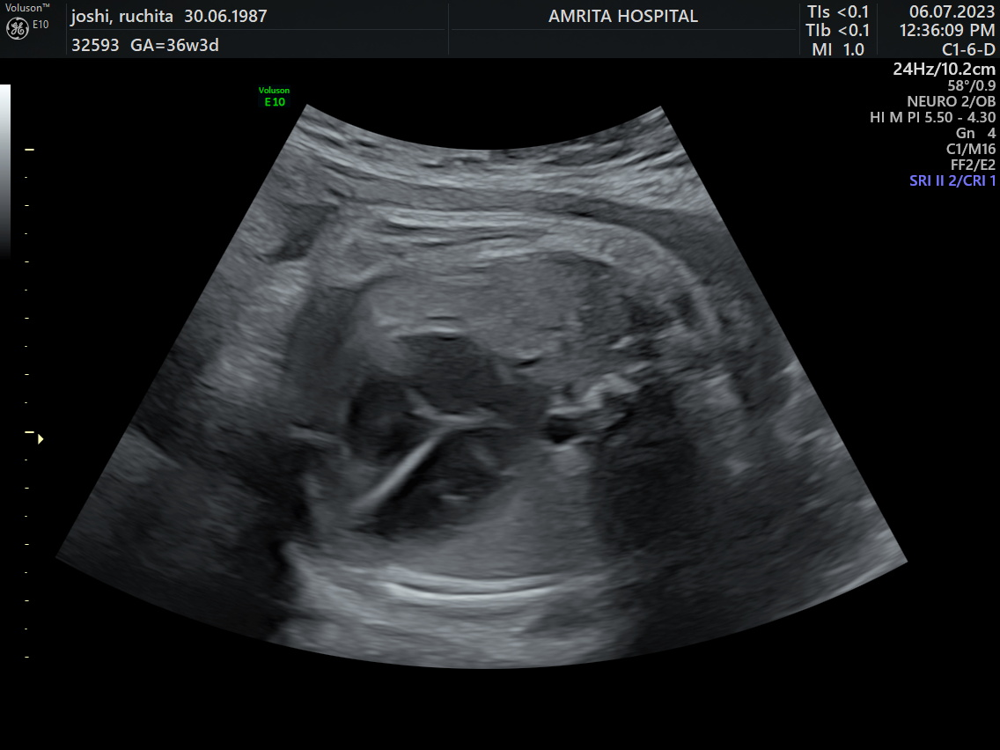

Gray scale image




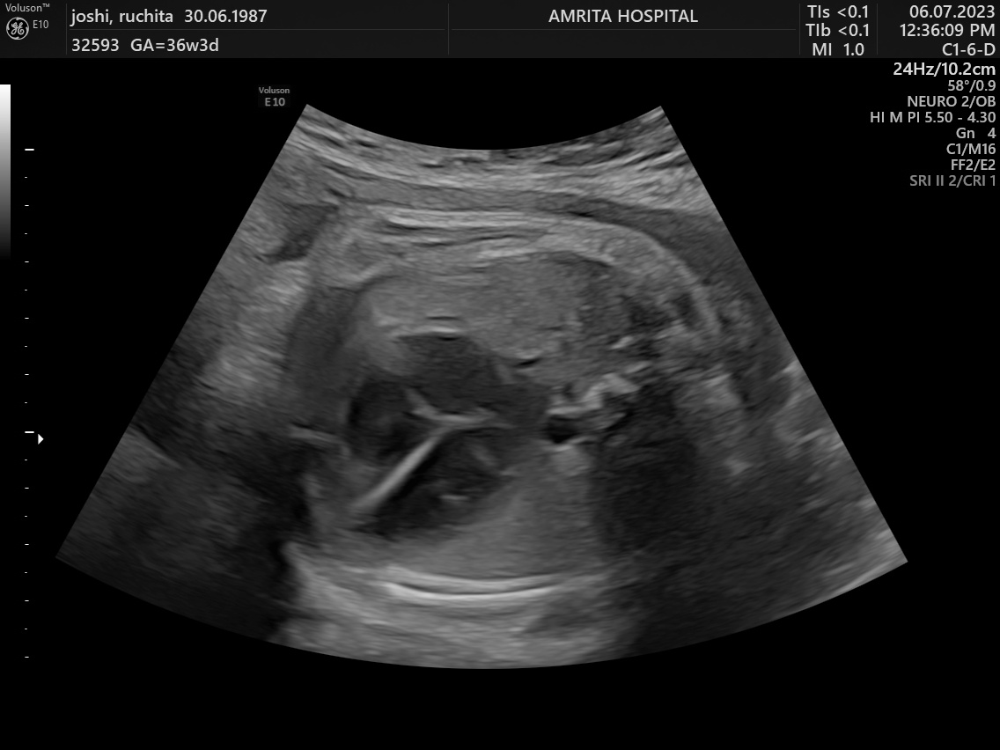

Applying clahe 




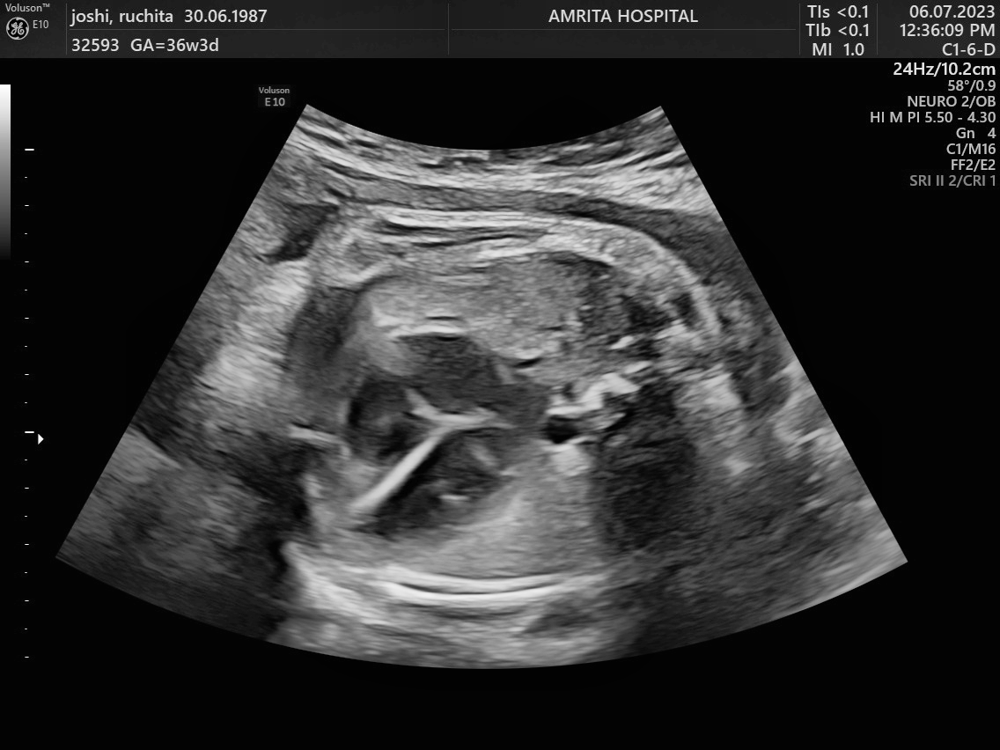

applying diffusion


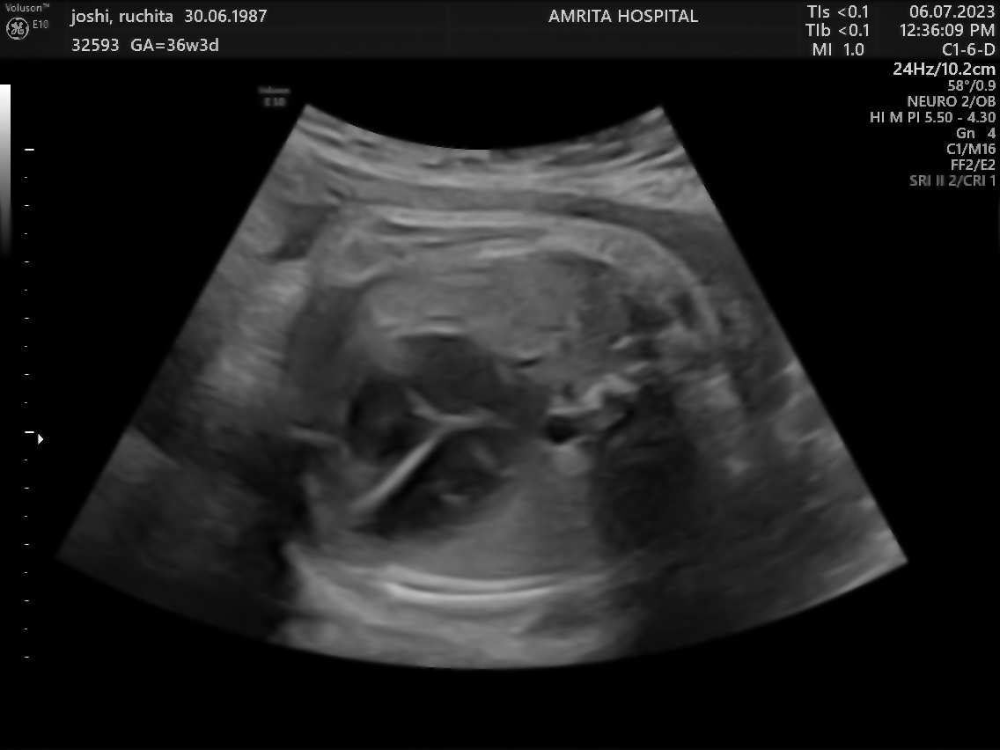

GLCM Features:
contrast: 	[143.13122893 222.44483246 124.49210126 212.83987949]
dissimilarity: 	[1.42932618 2.40011699 1.6219547  2.32177226]
homogeneity: 	[0.8130656  0.71485327 0.74176325 0.71727135]
energy: 	[0.4472091  0.44519812 0.44619756 0.44521287]
correlation: 	[0.95964747 0.93733793 0.96494576 0.94004362]
ASM: 	[0.19999598 0.19820136 0.19909226 0.1982145 ]


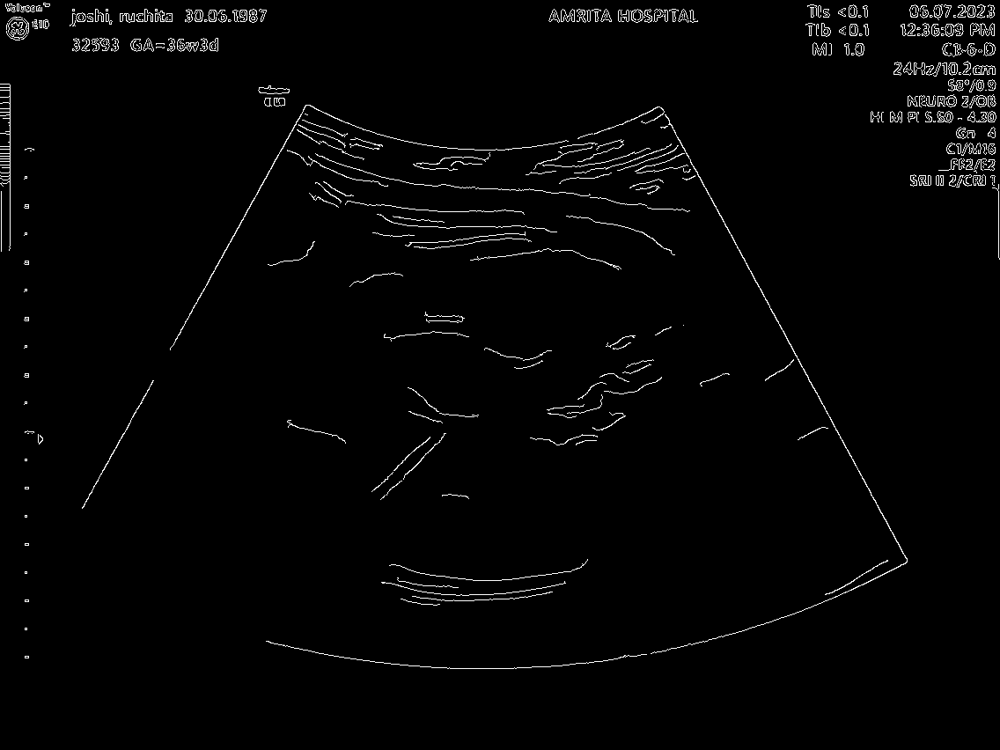

Applying edges
Processing complete for LUNG 2 SETTINGS_3.jpg. Results saved to /content/drive/My Drive/AIMS_Processed/LUNG 2 SETTINGS_3.

Processing image: LUNG_1 (1).jpg
Original image




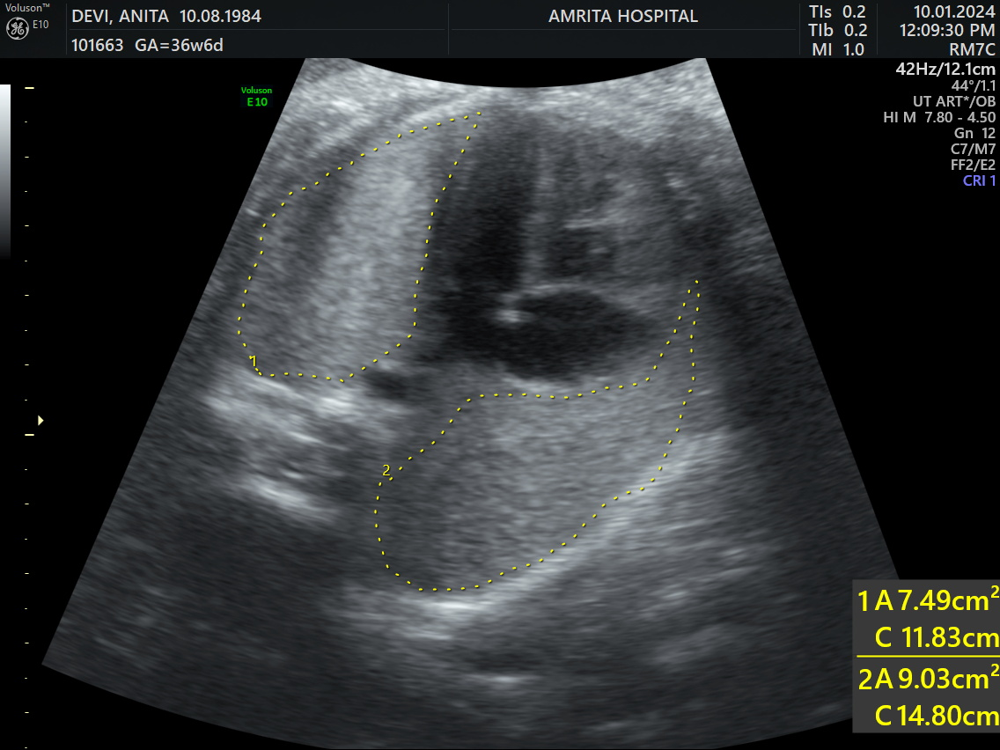

Gray scale image




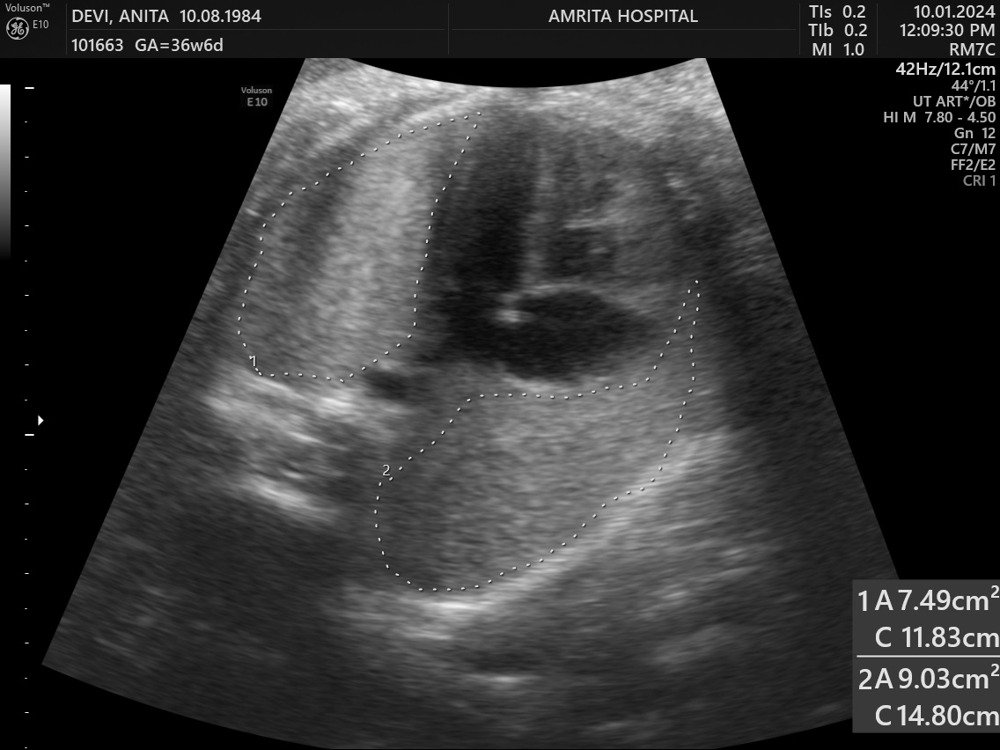

Applying clahe 




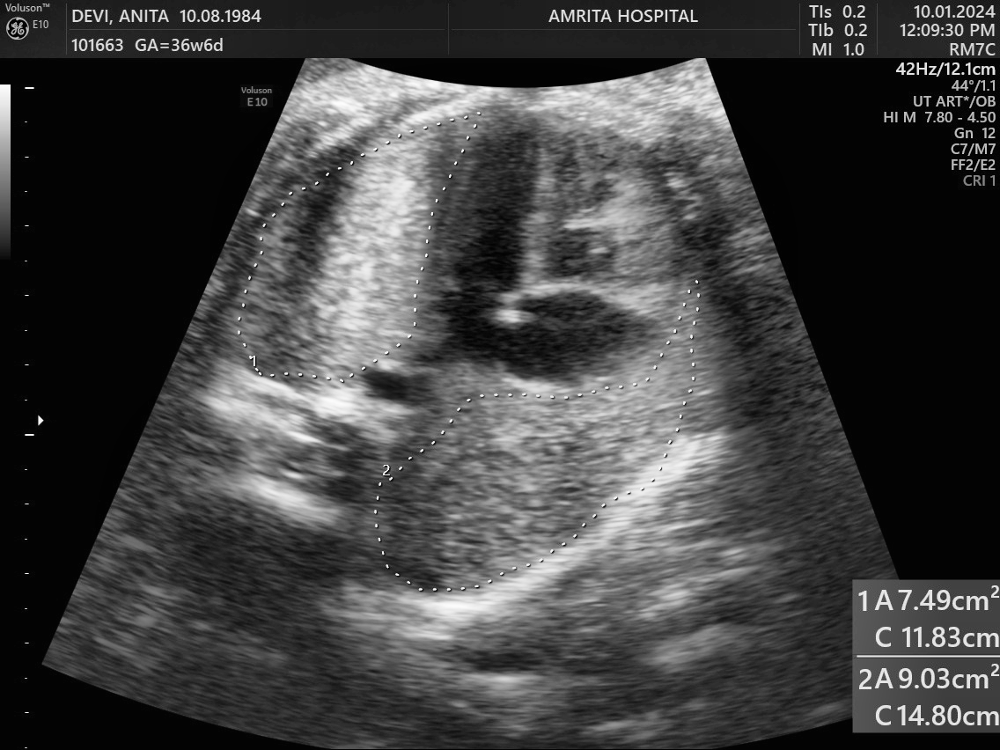

applying diffusion


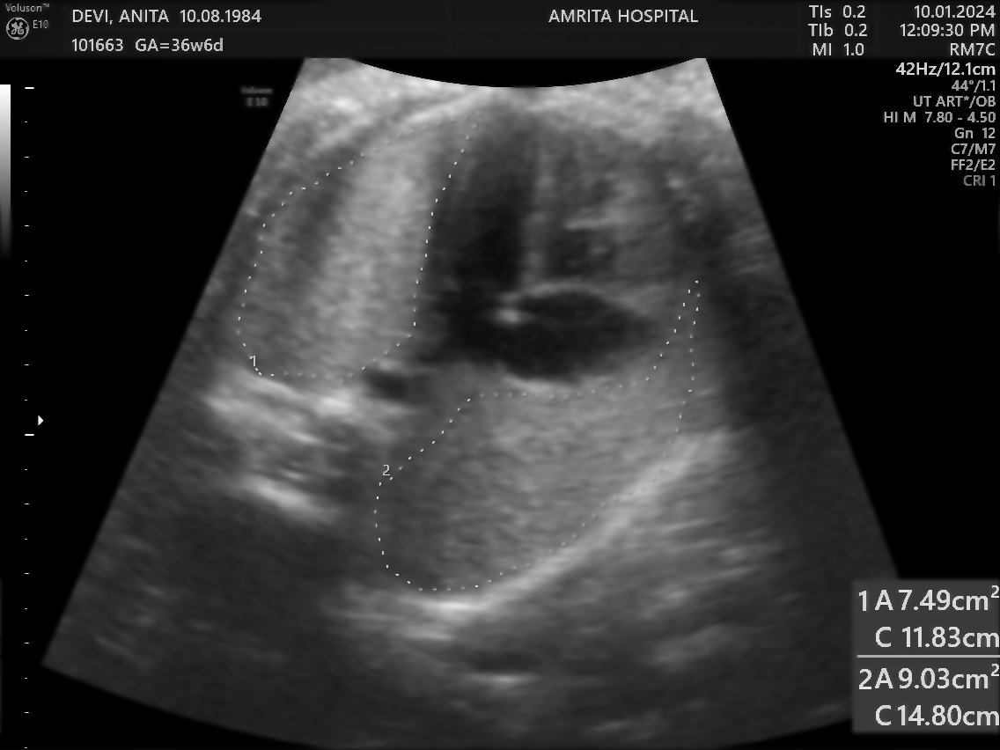

GLCM Features:
contrast: 	[193.48260946 301.80647386 168.60708094 285.82573288]
dissimilarity: 	[1.89057413 3.08244149 2.00459588 2.94432774]
homogeneity: 	[0.75660879 0.6344829  0.67382945 0.63865245]
energy: 	[0.27805195 0.2756003  0.27698964 0.27559878]
correlation: 	[0.96297235 0.94227369 0.96775745 0.94533032]
ASM: 	[0.07731288 0.07595552 0.07672326 0.07595469]


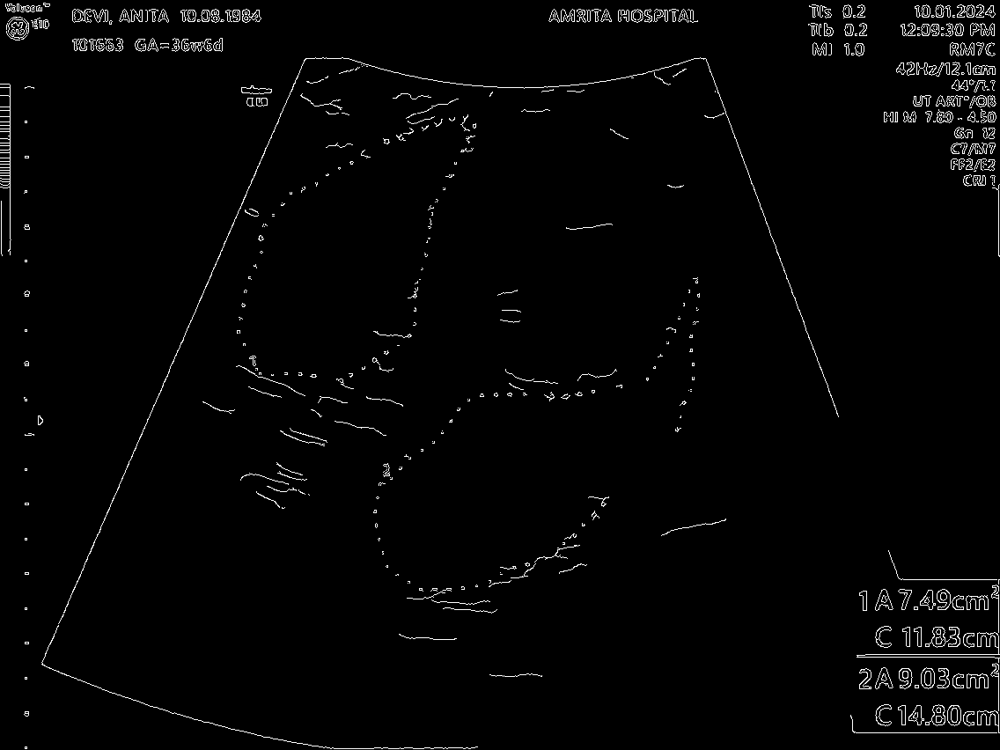

Applying edges
Processing complete for LUNG_1 (1).jpg. Results saved to /content/drive/My Drive/AIMS_Processed/LUNG_1 (1).

Processing image: LUNG 22 8_2.jpg
Original image




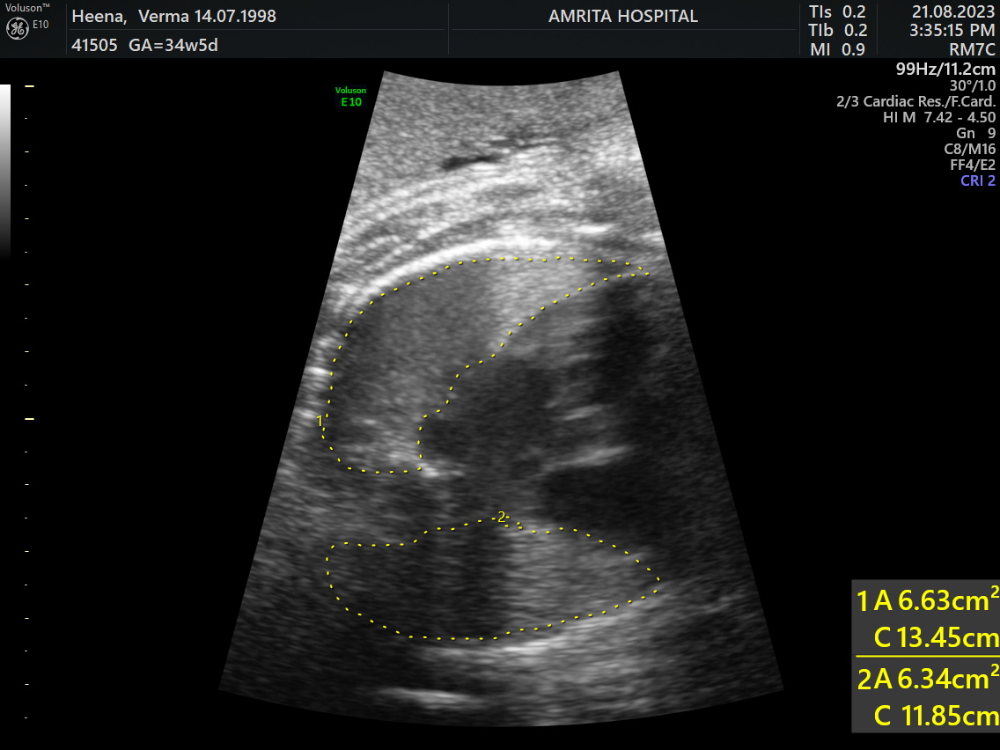

Gray scale image




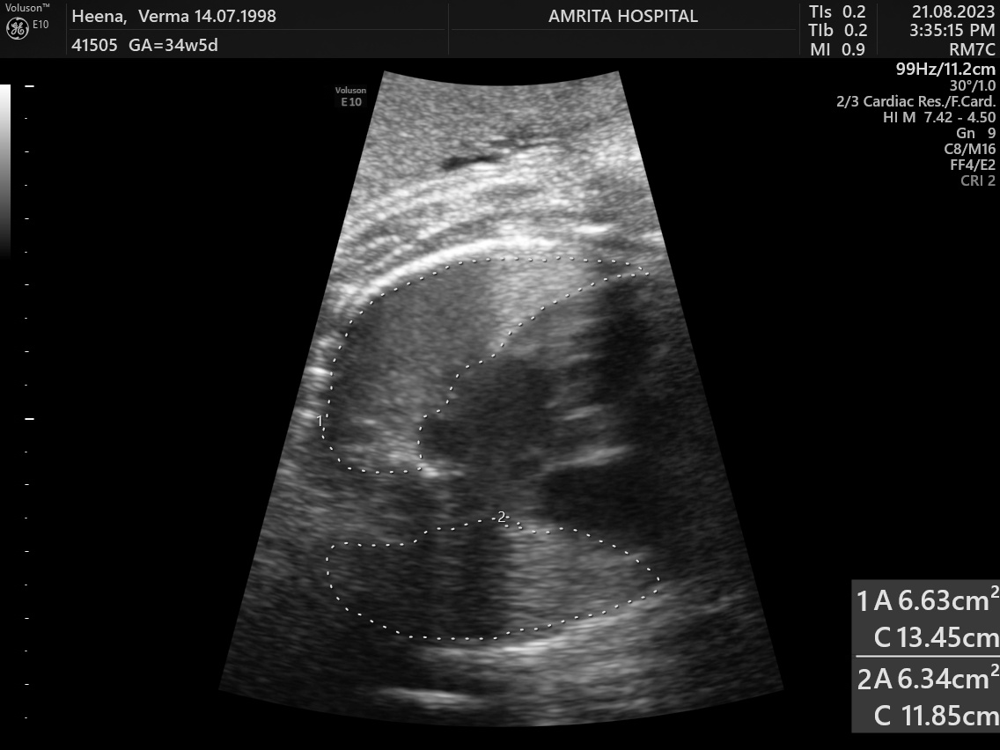

Applying clahe 




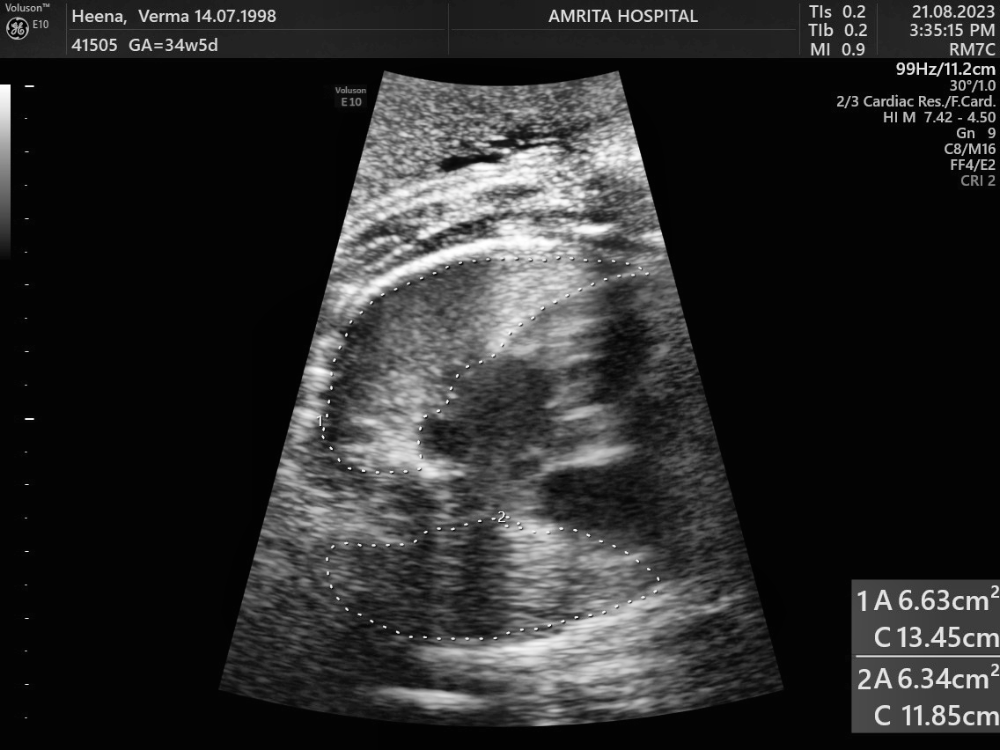

applying diffusion


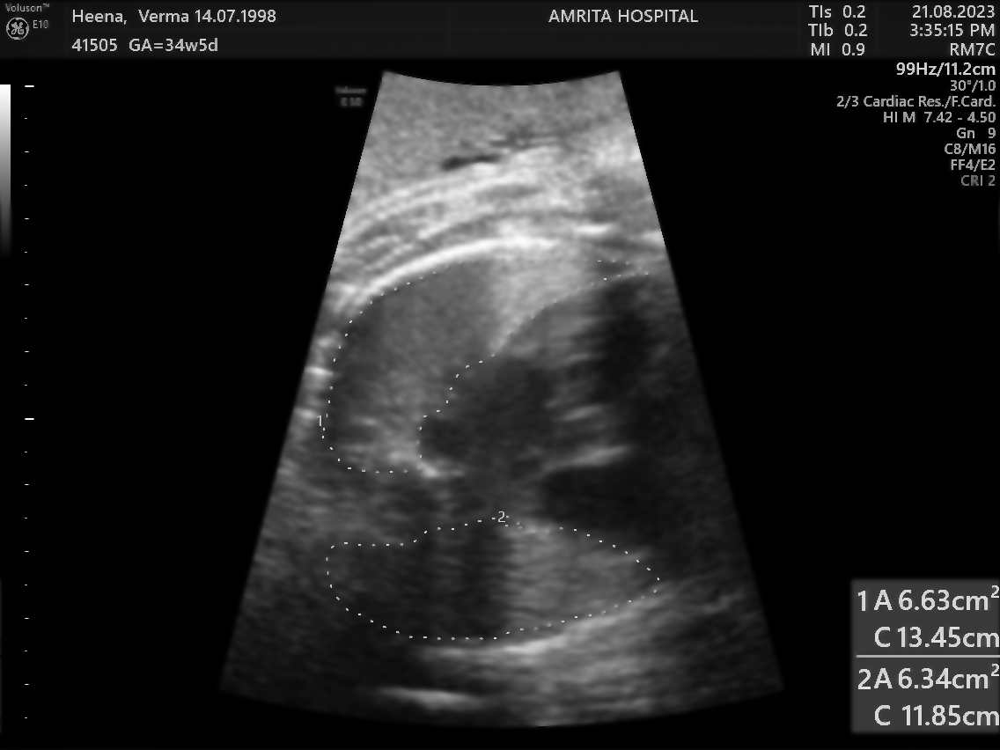

GLCM Features:
contrast: 	[190.86085707 304.26523862 173.98798017 287.85766007]
dissimilarity: 	[1.80738558 3.04586985 1.97173168 2.8538884 ]
homogeneity: 	[0.80738789 0.71852341 0.74982525 0.72187331]
energy: 	[0.50513163 0.50327784 0.50446785 0.5032451 ]
correlation: 	[0.96522559 0.94461479 0.96832605 0.94760145]
ASM: 	[0.25515796 0.25328858 0.25448782 0.25325564]


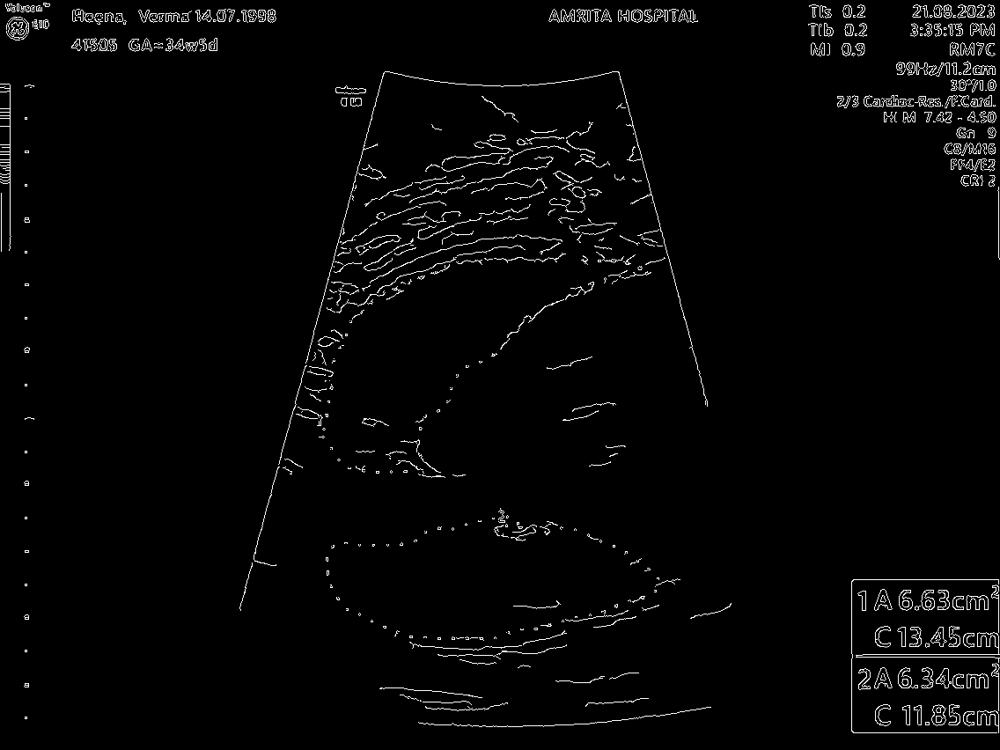

Applying edges
Processing complete for LUNG 22 8_2.jpg. Results saved to /content/drive/My Drive/AIMS_Processed/LUNG 22 8_2.



In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from google.colab.drive import mount
from google.colab.patches import cv2_imshow
from skimage.feature import graycomatrix, graycoprops

# Mount Google Drive
mount('/content/drive')
base_folder = '/content/drive/My Drive/AIMS'

# Check if the folder exists
if not os.path.exists(base_folder):
    print(f"Error: Folder {base_folder} does not exist.")
else:
    output_folder = '/content/drive/My Drive/AIMS_Processed'
    os.makedirs(output_folder, exist_ok=True)

    def anisotropic_diffusion(image, num_iter=10, kappa=50, gamma=0.1, option=1):
        """
        Perform anisotropic diffusion on an image.

        Parameters:
        - image: Input image (grayscale).
        - num_iter: Number of iterations to perform.
        - kappa: Gradient threshold for conduction coefficients.
        - gamma: Integration constant (time step).
        - option: Type of diffusion function (1: exponential, 2: quadratic).

        Returns:
        - diffused_image: Image after anisotropic diffusion.
        """
        image = image.astype(np.float32)
        diffused_image = image.copy()

        for _ in range(num_iter):
            # Compute gradients
            delta_n = np.roll(diffused_image, -1, axis=0) - diffused_image
            delta_s = np.roll(diffused_image, 1, axis=0) - diffused_image
            delta_e = np.roll(diffused_image, -1, axis=1) - diffused_image
            delta_w = np.roll(diffused_image, 1, axis=1) - diffused_image

            # Compute conduction coefficients
            if option == 1:  # Exponential function
                c_n = np.exp(-(delta_n / kappa) ** 2)
                c_s = np.exp(-(delta_s / kappa) ** 2)
                c_e = np.exp(-(delta_e / kappa) ** 2)
                c_w = np.exp(-(delta_w / kappa) ** 2)
            elif option == 2:  # Quadratic function
                c_n = 1 / (1 + (delta_n / kappa) ** 2)
                c_s = 1 / (1 + (delta_s / kappa) ** 2)
                c_e = 1 / (1 + (delta_e / kappa) ** 2)
                c_w = 1 / (1 + (delta_w / kappa) ** 2)
            else:
                raise ValueError("Invalid option for conduction coefficients. Use 1 or 2.")

            # Update the diffused image
            diffused_image += gamma * (
                c_n * delta_n + c_s * delta_s + c_e * delta_e + c_w * delta_w
            )

        return diffused_image

    def compute_glcm_features(image, distances, angles):
        """
        Compute GLCM and its properties for a grayscale image.

        Parameters:
            image (numpy.ndarray): Input grayscale image.
            distances (list): List of pixel pair distance offsets.
            angles (list): List of pixel pair angles in radians.

        Returns:
            dict: Dictionary of GLCM properties.
        """
        if not np.issubdtype(image.dtype, np.integer):
            image = (image * 255).astype(np.uint8) if image.max() <= 1 else image.astype(np.uint8)

        glcm = graycomatrix(image, distances=distances, angles=angles, levels=256, symmetric=True, normed=True)

        features = {
            'contrast': graycoprops(glcm, 'contrast').flatten(),
            'dissimilarity': graycoprops(glcm, 'dissimilarity').flatten(),
            'homogeneity': graycoprops(glcm, 'homogeneity').flatten(),
            'energy': graycoprops(glcm, 'energy').flatten(),
            'correlation': graycoprops(glcm, 'correlation').flatten(),
            'ASM': graycoprops(glcm, 'ASM').flatten(),
        }

        return features

    # Process each image in the folder
    for filename in os.listdir(base_folder):
        file_path = os.path.join(base_folder, filename)

        if os.path.isfile(file_path) and filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            print(f"Processing image: {filename}")
            image = cv2.imread(file_path)

            if image is None:
                print(f"Error: Unable to load image {filename}. Skipping.")
                continue

            # Create folder for each image's results
            image_output_folder = os.path.join(output_folder, filename.split('.')[0])
            os.makedirs(image_output_folder, exist_ok=True)

            # Display original image
            print("Original image\n\n")
            cv2_imshow(image)

            # Convert to grayscale
            gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            print("Gray scale image\n\n")
            cv2_imshow(gray_image)
            cv2.imwrite(os.path.join(image_output_folder, 'grayscale.jpg'), gray_image)

            # Apply CLAHE
            clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
            clahe_image = clahe.apply(gray_image)
            print("Applying clahe \n\n")
            cv2_imshow(clahe_image)
            cv2.imwrite(os.path.join(image_output_folder, 'clahe.jpg'), clahe_image)

            # Apply anisotropic diffusion
            diffused_image = anisotropic_diffusion(gray_image, num_iter=15, kappa=50, gamma=0.2, option=1)
            diffused_image_uint8 = np.uint8(cv2.normalize(diffused_image, None, 0, 255, cv2.NORM_MINMAX))
            print("applying diffusion")
            cv2_imshow(diffused_image_uint8)
            cv2.imwrite(os.path.join(image_output_folder, 'diffused.jpg'), diffused_image_uint8)

            # Compute GLCM features
            distances = [1]
            angles = [0, np.pi / 4, np.pi / 2, 3 * np.pi / 4]
            features = compute_glcm_features(diffused_image_uint8, distances, angles)

            print("GLCM Features:")
            for feature_name, values in features.items():
                print(f"{feature_name}: \t{values}")

            # Apply Canny edge detection
            edges = cv2.Canny(diffused_image_uint8, 0, 80)
            cv2_imshow(edges)
            print("Applying edges")
            cv2.imwrite(os.path.join(image_output_folder, 'edges.jpg'), edges)

            print(f"Processing complete for {filename}. Results saved to {image_output_folder}.\n")


Gestation Period 1 Excel

In [ ]:
import cv2
import numpy as np
import os
from google.colab.drive import mount
from skimage.feature import graycomatrix, graycoprops
import pandas as pd

# Mount Google Drive
mount('/content/drive')
base_folder = '/content/drive/My Drive/third_trim/25- 33.6 weeks gestation'

# Check if the folder exists
if not os.path.exists(base_folder):
    print(f"Error: Folder {base_folder} does not exist.")
else:
    output_folder = '/content/drive/My Drive/third_trim_gest1'
    os.makedirs(output_folder, exist_ok=True)

    def anisotropic_diffusion(image, num_iter=10, kappa=50, gamma=0.1, option=1):
        """
        Perform anisotropic diffusion on an image.
        """
        image = image.astype(np.float32)
        diffused_image = image.copy()

        for _ in range(num_iter):
            delta_n = np.roll(diffused_image, -1, axis=0) - diffused_image
            delta_s = np.roll(diffused_image, 1, axis=0) - diffused_image
            delta_e = np.roll(diffused_image, -1, axis=1) - diffused_image
            delta_w = np.roll(diffused_image, 1, axis=1) - diffused_image

            if option == 1:
                c_n = np.exp(-(delta_n / kappa) ** 2)
                c_s = np.exp(-(delta_s / kappa) ** 2)
                c_e = np.exp(-(delta_e / kappa) ** 2)
                c_w = np.exp(-(delta_w / kappa) ** 2)
            elif option == 2:
                c_n = 1 / (1 + (delta_n / kappa) ** 2)
                c_s = 1 / (1 + (delta_s / kappa) ** 2)
                c_e = 1 / (1 + (delta_e / kappa) ** 2)
                c_w = 1 / (1 + (delta_w / kappa) ** 2)
            else:
                raise ValueError("Invalid option for conduction coefficients. Use 1 or 2.")

            diffused_image += gamma * (
                c_n * delta_n + c_s * delta_s + c_e * delta_e + c_w * delta_w
            )

        return diffused_image

    def compute_glcm_features(image, distances, angles):
        """
        Compute GLCM and its properties for a grayscale image.
        """
        if not np.issubdtype(image.dtype, np.integer):
            image = (image * 255).astype(np.uint8) if image.max() <= 1 else image.astype(np.uint8)

        glcm = graycomatrix(image, distances=distances, angles=angles, levels=256, symmetric=True, normed=True)

        features = {
            'contrast': graycoprops(glcm, 'contrast').flatten(),
            'dissimilarity': graycoprops(glcm, 'dissimilarity').flatten(),
            'homogeneity': graycoprops(glcm, 'homogeneity').flatten(),
            'energy': graycoprops(glcm, 'energy').flatten(),
            'correlation': graycoprops(glcm, 'correlation').flatten(),
            'ASM': graycoprops(glcm, 'ASM').flatten(),
        }

        return features

    # Define Excel columns
    columns = [
        'image_name', 'distance',
        'contrast_0_degrees', 'homogeneity_0_degrees', 'energy_0_degrees', 'correlation_0_degrees',
        'contrast_45_degrees', 'homogeneity_45_degrees', 'energy_45_degrees', 'correlation_45_degrees',
        'contrast_90_degrees', 'homogeneity_90_degrees', 'energy_90_degrees', 'correlation_90_degrees',
        'contrast_135_degrees', 'homogeneity_135_degrees', 'energy_135_degrees', 'correlation_135_degrees'
    ]

    # Initialize DataFrame
    glcm_data = []

    # Process each image in the folder
    for filename in os.listdir(base_folder):
        file_path = os.path.join(base_folder, filename)

        if os.path.isfile(file_path) and filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            print(f"Processing image: {filename}")
            image = cv2.imread(file_path)

            if image is None:
                print(f"Error: Unable to load image {filename}. Skipping.")
                continue

            # Convert to grayscale
            gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

            # Apply CLAHE
            clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
            clahe_image = clahe.apply(gray_image)

            # Apply anisotropic diffusion
            diffused_image = anisotropic_diffusion(clahe_image, num_iter=15, kappa=50, gamma=0.2, option=1)
            diffused_image_uint8 = np.uint8(cv2.normalize(diffused_image, None, 0, 255, cv2.NORM_MINMAX))

            # Compute GLCM features for specified distances
            distances = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20, 50]
            angles = [0, np.pi / 4, np.pi / 2, 3 * np.pi / 4]

            for d in distances:
                features = compute_glcm_features(diffused_image_uint8, distances=[d], angles=angles)
                row = [filename, d]
                for angle_idx in range(len(angles)):
                    row.extend([
                        features['contrast'][angle_idx],
                        features['homogeneity'][angle_idx],
                        features['energy'][angle_idx],
                        features['correlation'][angle_idx],
                    ])
                glcm_data.append(row)

    # Save GLCM data to Excel
    output_excel_path = os.path.join(output_folder, 'glcm_features.xlsx')
    glcm_df = pd.DataFrame(glcm_data, columns=columns)
    glcm_df.to_excel(output_excel_path, index=False)

    print(f"GLCM feature extraction complete. Results saved to {output_excel_path}.")

Mounted at /content/drive
Processing image: 22 8 10.jpg
Processing image: 22 8 11.jpg
Processing image: 22 8 12_1.jpg
Processing image: 22 8 12_2.jpg
Processing image: 22 8 13_1.jpg
Processing image: 22 8 13_2.jpg
Processing image: 22 8 16_1.jpg
Processing image: 22 8 16_2.jpg
Processing image: 22 8 19_1.jpg
Processing image: 22 8 19_2.jpg
Processing image: 22 8 21_1.jpg
Processing image: 22 8 21_2.jpg
Processing image: 22 8 22_1.jpg
Processing image: 22 8 22_2.jpg
Processing image: 22 8 23.jpg
Processing image: 22 8 24.jpg
Processing image: 22 8 7_1.jpg
Processing image: 22 8 7_2.jpg
Processing image: 22 8 9.jpg
Processing image: 24_1.jpg
Processing image: 24_2.jpg
Processing image: 247_1.jpg
Processing image: 247_2.jpg
Processing image: 54508 saroj.jpg
Processing image: 54508.jpg
Processing image: 58 LUNG.jpg
Processing image: 58 LUNG_1 (3).jpg
Processing image: 58 LUNG_1 (4).jpg
Processing image: 58 LUNG_1.jpg
Processing image: 58 LUNG_2 (3).jpg
Processing image: 58 LUNG_2 (4).jpg
P

Gestation Period 2 Excel

In [ ]:
import cv2
import numpy as np
import os
from google.colab.drive import mount
from skimage.feature import graycomatrix, graycoprops
import pandas as pd

# Mount Google Drive
mount('/content/drive')
base_folder = '/content/drive/My Drive/third_trim/34-36.6 weeks gestation'

# Check if the folder exists
if not os.path.exists(base_folder):
    print(f"Error: Folder {base_folder} does not exist.")
else:
    output_folder = '/content/drive/My Drive/third_trim_gest2'
    os.makedirs(output_folder, exist_ok=True)

    def anisotropic_diffusion(image, num_iter=10, kappa=50, gamma=0.1, option=1):
        """
        Perform anisotropic diffusion on an image.
        """
        image = image.astype(np.float32)
        diffused_image = image.copy()

        for _ in range(num_iter):
            delta_n = np.roll(diffused_image, -1, axis=0) - diffused_image
            delta_s = np.roll(diffused_image, 1, axis=0) - diffused_image
            delta_e = np.roll(diffused_image, -1, axis=1) - diffused_image
            delta_w = np.roll(diffused_image, 1, axis=1) - diffused_image

            if option == 1:
                c_n = np.exp(-(delta_n / kappa) ** 2)
                c_s = np.exp(-(delta_s / kappa) ** 2)
                c_e = np.exp(-(delta_e / kappa) ** 2)
                c_w = np.exp(-(delta_w / kappa) ** 2)
            elif option == 2:
                c_n = 1 / (1 + (delta_n / kappa) ** 2)
                c_s = 1 / (1 + (delta_s / kappa) ** 2)
                c_e = 1 / (1 + (delta_e / kappa) ** 2)
                c_w = 1 / (1 + (delta_w / kappa) ** 2)
            else:
                raise ValueError("Invalid option for conduction coefficients. Use 1 or 2.")

            diffused_image += gamma * (
                c_n * delta_n + c_s * delta_s + c_e * delta_e + c_w * delta_w
            )

        return diffused_image

    def compute_glcm_features(image, distances, angles):
        """
        Compute GLCM and its properties for a grayscale image.
        """
        if not np.issubdtype(image.dtype, np.integer):
            image = (image * 255).astype(np.uint8) if image.max() <= 1 else image.astype(np.uint8)

        glcm = graycomatrix(image, distances=distances, angles=angles, levels=256, symmetric=True, normed=True)

        features = {
            'contrast': graycoprops(glcm, 'contrast').flatten(),
            'dissimilarity': graycoprops(glcm, 'dissimilarity').flatten(),
            'homogeneity': graycoprops(glcm, 'homogeneity').flatten(),
            'energy': graycoprops(glcm, 'energy').flatten(),
            'correlation': graycoprops(glcm, 'correlation').flatten(),
            'ASM': graycoprops(glcm, 'ASM').flatten(),
        }

        return features

    # Define Excel columns
    columns = [
        'image_name', 'distance',
        'contrast_0_degrees', 'homogeneity_0_degrees', 'energy_0_degrees', 'correlation_0_degrees',
        'contrast_45_degrees', 'homogeneity_45_degrees', 'energy_45_degrees', 'correlation_45_degrees',
        'contrast_90_degrees', 'homogeneity_90_degrees', 'energy_90_degrees', 'correlation_90_degrees',
        'contrast_135_degrees', 'homogeneity_135_degrees', 'energy_135_degrees', 'correlation_135_degrees'
    ]

    # Initialize DataFrame
    glcm_data = []

    # Process each image in the folder
    for filename in os.listdir(base_folder):
        file_path = os.path.join(base_folder, filename)

        if os.path.isfile(file_path) and filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            print(f"Processing image: {filename}")
            image = cv2.imread(file_path)

            if image is None:
                print(f"Error: Unable to load image {filename}. Skipping.")
                continue

            # Convert to grayscale
            gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

            # Apply CLAHE
            clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
            clahe_image = clahe.apply(gray_image)

            # Apply anisotropic diffusion
            diffused_image = anisotropic_diffusion(clahe_image, num_iter=15, kappa=50, gamma=0.2, option=1)
            diffused_image_uint8 = np.uint8(cv2.normalize(diffused_image, None, 0, 255, cv2.NORM_MINMAX))

            # Compute GLCM features for specified distances
            distances = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20, 50]
            angles = [0, np.pi / 4, np.pi / 2, 3 * np.pi / 4]

            for d in distances:
                features = compute_glcm_features(diffused_image_uint8, distances=[d], angles=angles)
                row = [filename, d]
                for angle_idx in range(len(angles)):
                    row.extend([
                        features['contrast'][angle_idx],
                        features['homogeneity'][angle_idx],
                        features['energy'][angle_idx],
                        features['correlation'][angle_idx],
                    ])
                glcm_data.append(row)

    # Save GLCM data to Excel
    output_excel_path = os.path.join(output_folder, 'glcm_features.xlsx')
    glcm_df = pd.DataFrame(glcm_data, columns=columns)
    glcm_df.to_excel(output_excel_path, index=False)

    print(f"GLCM feature extraction complete. Results saved to {output_excel_path}.")

Mounted at /content/drive
Processing image: 22 8 11.jpg
Processing image: 22 8 14_1.jpg
Processing image: 22 8 14_2.jpg
Processing image: 54328 2.jpg
Processing image: 54328.jpg
Processing image: 58 LUNG_1 (2).jpg
Processing image: 58 LUNG_2 (2).jpg
Processing image: BUSHRA LUNG_1.jpg
Processing image: BUSHRA LUNG_2.jpg
Processing image: KUMARI_RITU LUNG_1.jpg
Processing image: KUMARI_RITU LUNG_2.jpg
Processing image: LUNG 2 SETTINGS_1.jpg
Processing image: LUNG 2 SETTINGS_3.jpg
Processing image: LUNG 22 8_1.jpg
Processing image: LUNG 22 8_2.jpg
Processing image: LUNG_1 (1).jpg
Processing image: LUNG_1 (2).jpg
Processing image: LUNG_1.jpg
Processing image: LUNG_2 (1).jpg
Processing image: LUNG_2 (2).jpg
Processing image: LUNG_2.jpg
Processing image: sharma_meenakshi LUNG.jpg
Processing image: SHARMA_RAGINI LUNG_1.jpg
Processing image: SHARMA_RAGINI LUNG_2.jpg
Processing image: SHIVANI LUNG_1.jpg
Processing image: SHIVANI LUNG_2.jpg
Processing image: SILKY LUNG_1.jpg
Processing image: S

Gestation Period 3 Excel

In [ ]:
import cv2
import numpy as np
import os
from google.colab.drive import mount
from skimage.feature import graycomatrix, graycoprops
import pandas as pd

# Mount Google Drive
mount('/content/drive')
base_folder = '/content/drive/My Drive/third_trim/37-38.6 weeks gestation'

# Check if the folder exists
if not os.path.exists(base_folder):
    print(f"Error: Folder {base_folder} does not exist.")
else:
    output_folder = '/content/drive/My Drive/third_trim_gest3'
    os.makedirs(output_folder, exist_ok=True)

    def anisotropic_diffusion(image, num_iter=10, kappa=50, gamma=0.1, option=1):
        """
        Perform anisotropic diffusion on an image.
        """
        image = image.astype(np.float32)
        diffused_image = image.copy()

        for _ in range(num_iter):
            delta_n = np.roll(diffused_image, -1, axis=0) - diffused_image
            delta_s = np.roll(diffused_image, 1, axis=0) - diffused_image
            delta_e = np.roll(diffused_image, -1, axis=1) - diffused_image
            delta_w = np.roll(diffused_image, 1, axis=1) - diffused_image

            if option == 1:
                c_n = np.exp(-(delta_n / kappa) ** 2)
                c_s = np.exp(-(delta_s / kappa) ** 2)
                c_e = np.exp(-(delta_e / kappa) ** 2)
                c_w = np.exp(-(delta_w / kappa) ** 2)
            elif option == 2:
                c_n = 1 / (1 + (delta_n / kappa) ** 2)
                c_s = 1 / (1 + (delta_s / kappa) ** 2)
                c_e = 1 / (1 + (delta_e / kappa) ** 2)
                c_w = 1 / (1 + (delta_w / kappa) ** 2)
            else:
                raise ValueError("Invalid option for conduction coefficients. Use 1 or 2.")

            diffused_image += gamma * (
                c_n * delta_n + c_s * delta_s + c_e * delta_e + c_w * delta_w
            )

        return diffused_image

    def compute_glcm_features(image, distances, angles):
        """
        Compute GLCM and its properties for a grayscale image.
        """
        if not np.issubdtype(image.dtype, np.integer):
            image = (image * 255).astype(np.uint8) if image.max() <= 1 else image.astype(np.uint8)

        glcm = graycomatrix(image, distances=distances, angles=angles, levels=256, symmetric=True, normed=True)

        features = {
            'contrast': graycoprops(glcm, 'contrast').flatten(),
            'dissimilarity': graycoprops(glcm, 'dissimilarity').flatten(),
            'homogeneity': graycoprops(glcm, 'homogeneity').flatten(),
            'energy': graycoprops(glcm, 'energy').flatten(),
            'correlation': graycoprops(glcm, 'correlation').flatten(),
            'ASM': graycoprops(glcm, 'ASM').flatten(),
        }

        return features

    # Define Excel columns
    columns = [
        'image_name', 'distance',
        'contrast_0_degrees', 'homogeneity_0_degrees', 'energy_0_degrees', 'correlation_0_degrees',
        'contrast_45_degrees', 'homogeneity_45_degrees', 'energy_45_degrees', 'correlation_45_degrees',
        'contrast_90_degrees', 'homogeneity_90_degrees', 'energy_90_degrees', 'correlation_90_degrees',
        'contrast_135_degrees', 'homogeneity_135_degrees', 'energy_135_degrees', 'correlation_135_degrees'
    ]

    # Initialize DataFrame
    glcm_data = []

    # Process each image in the folder
    for filename in os.listdir(base_folder):
        file_path = os.path.join(base_folder, filename)

        if os.path.isfile(file_path) and filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            print(f"Processing image: {filename}")
            image = cv2.imread(file_path)

            if image is None:
                print(f"Error: Unable to load image {filename}. Skipping.")
                continue

            # Convert to grayscale
            gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

            # Apply CLAHE
            clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
            clahe_image = clahe.apply(gray_image)

            # Apply anisotropic diffusion
            diffused_image = anisotropic_diffusion(clahe_image, num_iter=15, kappa=50, gamma=0.2, option=1)
            diffused_image_uint8 = np.uint8(cv2.normalize(diffused_image, None, 0, 255, cv2.NORM_MINMAX))

            # Compute GLCM features for specified distances
            distances = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 20, 50]
            angles = [0, np.pi / 4, np.pi / 2, 3 * np.pi / 4]

            for d in distances:
                features = compute_glcm_features(diffused_image_uint8, distances=[d], angles=angles)
                row = [filename, d]
                for angle_idx in range(len(angles)):
                    row.extend([
                        features['contrast'][angle_idx],
                        features['homogeneity'][angle_idx],
                        features['energy'][angle_idx],
                        features['correlation'][angle_idx],
                    ])
                glcm_data.append(row)

    # Save GLCM data to Excel
    output_excel_path = os.path.join(output_folder, 'glcm_features.xlsx')
    glcm_df = pd.DataFrame(glcm_data, columns=columns)
    glcm_df.to_excel(output_excel_path, index=False)

    print(f"GLCM feature extraction complete. Results saved to {output_excel_path}.")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Processing image: 22 8  8_1.jpg
Processing image: 22 8  8_2.jpg
Processing image: 22 8 13_1.jpg
Processing image: 22 8 13_2.jpg
Processing image: 22 8 21_1.jpg
Processing image: 22 8 21_2.jpg
Processing image: LUNG 22 8 2_1.jpg
Processing image: LUNG 22 8 2_2.jpg
Processing image: MONICA LUNG_1.jpg
Processing image: MONICA LUNG_2.jpg
GLCM feature extraction complete. Results saved to /content/drive/My Drive/third_trim_gest3/glcm_features.xlsx.
